In [ ]:
# Mount Google Drive

from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [ ]:
import os
from tqdm import tqdm
import time
import copy
import gc

import torchvision
from torchvision import datasets, models, transforms

from PIL import Image

import pickle

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
import numpy as np

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay


import matplotlib.pyplot as plt

cudnn.benchmark = True

### Funções auxiliares

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

def visualize_model(model, dataloaders, class_names, device, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]}, label: {class_names[labels[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
    ])
    
    class_names = [1, 2, 3]
    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        dataset_sizes = {x: 0 for x in ['train', 'val']}
        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
                batch_files = [f'train_{x+1}' for x in range(6)]
            else:
                model.eval()   # Set model to evaluate mode
                batch_files = [f'val_{x+1}' for x in range(2)]

            running_loss = 0.0
            running_corrects = 0

            # Set the dataloaders for each batch
            for batch_file in batch_files:
              # Carrega as imagens pré-processadas de cada dataset
              with open(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/batch data/leave out test/{batch_file}.pkl', 'rb') as f:
                  data = pickle.load(f)

              # Normalização e conversão em tensores
              data = [(transform(img), label) for img, label in data]

              if phase == 'train':
                image_datasets = {'train': data, 'val': []}
                dataloaders = {'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=4,
                                                          shuffle=True, num_workers=4),
                               'val': []}
              else:
                image_datasets = {'train': [], 'val': data}
                dataloaders = {'train': [],
                               'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=4,
                                                          shuffle=True, num_workers=4)}
              

              dataset_sizes = {x: dataset_sizes[x]+len(image_datasets[x]) for x in ['train', 'val']}

              # Iterate over data.
              for inputs, labels in tqdm(dataloaders[phase]):
                  inputs = inputs.to(device)
                  labels = labels.to(device)

                  # zero the parameter gradients
                  optimizer.zero_grad()

                  # forward
                  # track history if only in train
                  with torch.set_grad_enabled(phase == 'train'):
                      outputs = model(inputs)
                      _, preds = torch.max(outputs, 1)
                      loss = criterion(outputs, labels)

                      # backward + optimize only if in training phase
                      if phase == 'train':
                          loss.backward()
                          optimizer.step()

                  # statistics
                  running_loss += loss.item() * inputs.size(0)
                  running_corrects += torch.sum(preds == labels.data)
              if phase == 'train':
                  scheduler.step()

              epoch_loss = running_loss / dataset_sizes[phase]
              epoch_acc = running_corrects.double() / dataset_sizes[phase]

              print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f} ({running_corrects.double()}/{dataset_sizes[phase]}) \n')

              # deep copy the model
              if phase == 'val' and epoch_acc > best_acc:
                  best_acc = epoch_acc
                  best_model_wts = copy.deepcopy(model.state_dict())
              
              # Delete current partial dataset
              del data
              del image_datasets
              del dataloaders
              gc.collect()

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

### Teste

In [ ]:
def test_model(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '_2058_224.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

Device: cuda:0
Model loaded from vgg16_leave_out_tpn.


  0%|          | 0/6 [00:00<?, ?it/s]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:1782/1798
Acurácia: 0.9911012235817576
----------------------


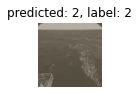

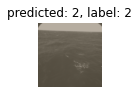

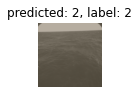

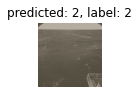

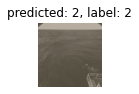

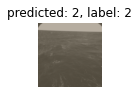

 17%|█▋        | 1/6 [00:21<01:47, 21.45s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:980/1796
Acurácia: 0.5456570155902004
----------------------


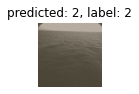

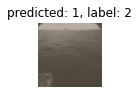

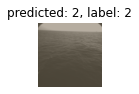

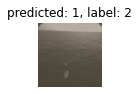

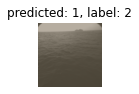

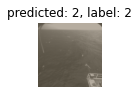

 33%|███▎      | 2/6 [00:43<01:27, 21.91s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:1789/1798
Acurácia: 0.9949944382647385
----------------------


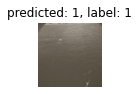

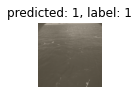

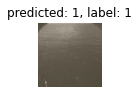

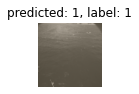

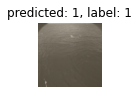

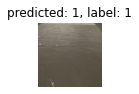

 50%|█████     | 3/6 [01:05<01:05, 21.86s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:1798/1798
Acurácia: 1.0
----------------------


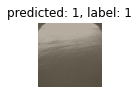

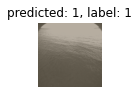

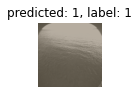

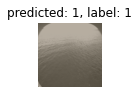

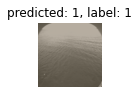

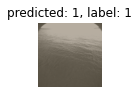

 67%|██████▋   | 4/6 [01:27<00:43, 21.98s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:1793/1798
Acurácia: 0.9972191323692993
----------------------


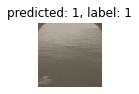

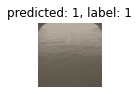

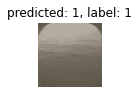

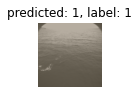

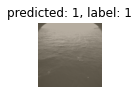

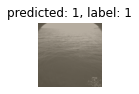

 83%|████████▎ | 5/6 [01:49<00:22, 22.11s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:1799/1800
Acurácia: 0.9994444444444445
----------------------


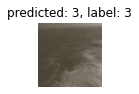

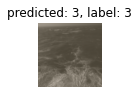

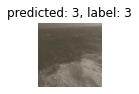

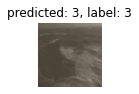

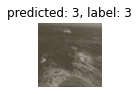

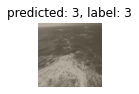

100%|██████████| 6/6 [02:12<00:00, 22.05s/it]


In [ ]:
datasets = ['AA_2015_2015-03-05_10-35-00_12Hz', 'AA_2015_2015-05-15_09-00-00_12Hz', 'BS_2011_2011-10-04_15-30-00_12Hz', 'BS_2013_2013-09-22_13-00-01_10Hz',
            'BS_2013_2013-09-30_10-20-01_12Hz', 'LJ_2018_2018-01-03_09-39-38_10Hz']
test_model(datasets, 'vgg16_leave_out_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1798/1799
Acurácia: 0.9994441356309061
----------------------


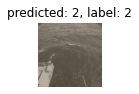

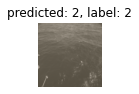

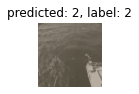

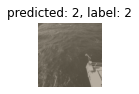

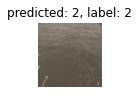

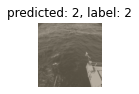

  8%|▊         | 1/12 [00:29<05:22, 29.29s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


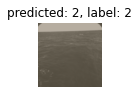

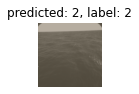

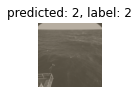

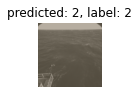

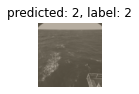

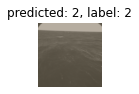

 17%|█▋        | 2/12 [00:42<03:17, 19.76s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


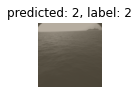

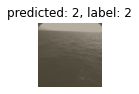

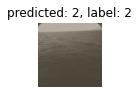

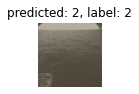

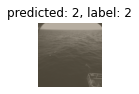

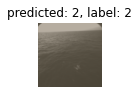

 25%|██▌       | 3/12 [00:55<02:29, 16.58s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


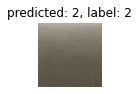

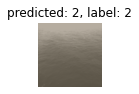

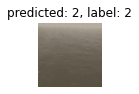

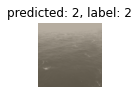

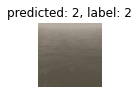

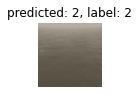

 33%|███▎      | 4/12 [01:00<01:37, 12.23s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


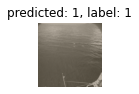

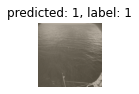

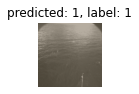

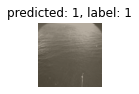

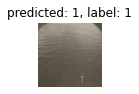

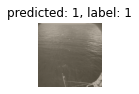

 42%|████▏     | 5/12 [01:07<01:11, 10.17s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


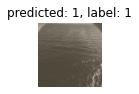

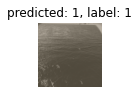

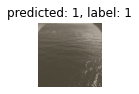

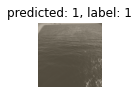

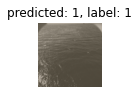

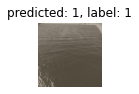

 50%|█████     | 6/12 [01:16<00:58,  9.80s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


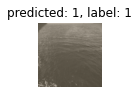

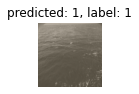

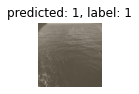

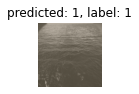

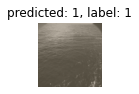

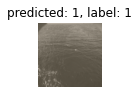

 58%|█████▊    | 7/12 [01:30<00:56, 11.36s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


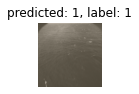

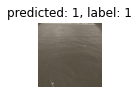

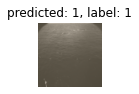

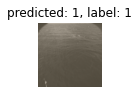

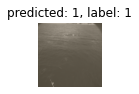

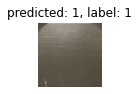

 67%|██████▋   | 8/12 [01:45<00:50, 12.52s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


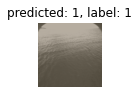

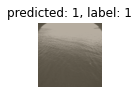

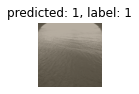

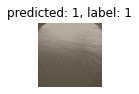

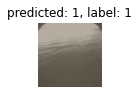

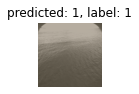

 75%|███████▌  | 9/12 [01:58<00:37, 12.42s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


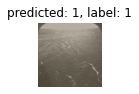

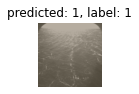

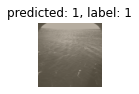

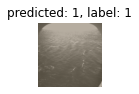

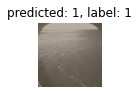

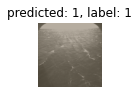

 83%|████████▎ | 10/12 [02:11<00:25, 12.69s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


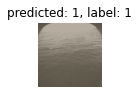

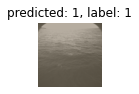

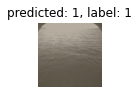

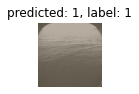

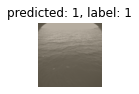

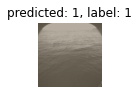

 92%|█████████▏| 11/12 [02:25<00:13, 13.12s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


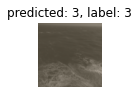

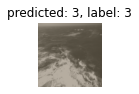

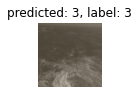

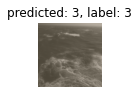

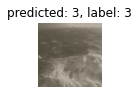

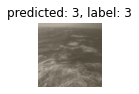

100%|██████████| 12/12 [02:37<00:00, 13.15s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'vgg16_splitted_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1795/1799
Acurácia: 0.9977765425236242
----------------------


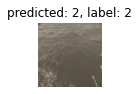

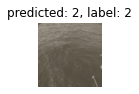

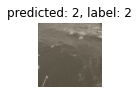

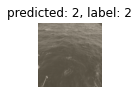

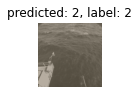

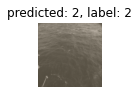

  8%|▊         | 1/12 [00:21<03:56, 21.47s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


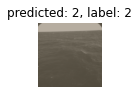

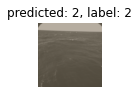

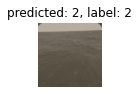

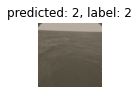

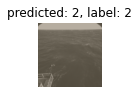

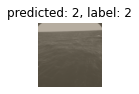

 17%|█▋        | 2/12 [00:32<02:34, 15.42s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


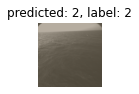

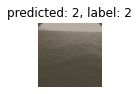

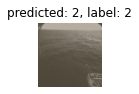

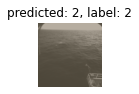

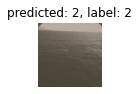

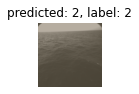

 25%|██▌       | 3/12 [00:44<02:04, 13.81s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


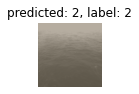

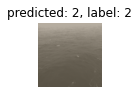

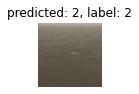

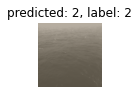

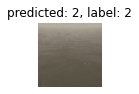

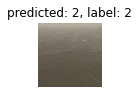

 33%|███▎      | 4/12 [00:49<01:21, 10.24s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


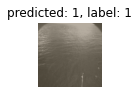

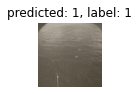

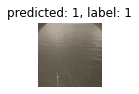

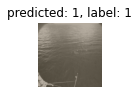

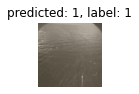

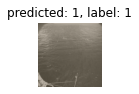

 42%|████▏     | 5/12 [00:54<00:59,  8.44s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


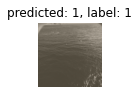

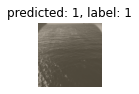

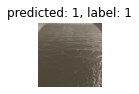

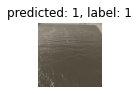

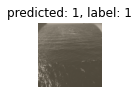

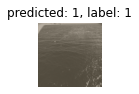

 50%|█████     | 6/12 [01:02<00:49,  8.19s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


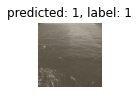

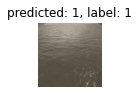

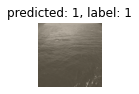

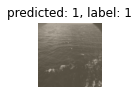

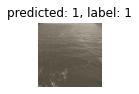

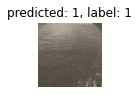

 58%|█████▊    | 7/12 [01:13<00:46,  9.29s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


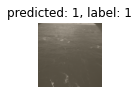

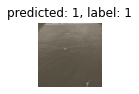

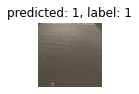

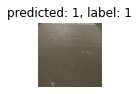

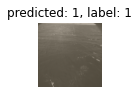

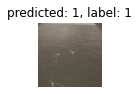

 67%|██████▋   | 8/12 [01:25<00:40, 10.00s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


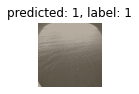

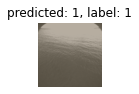

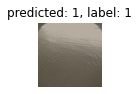

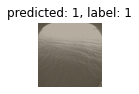

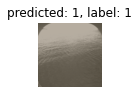

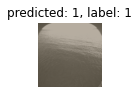

 75%|███████▌  | 9/12 [01:36<00:31, 10.37s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


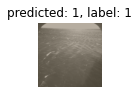

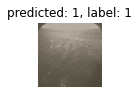

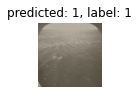

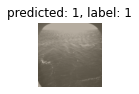

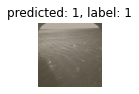

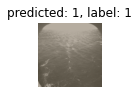

 83%|████████▎ | 10/12 [01:47<00:21, 10.69s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


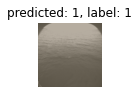

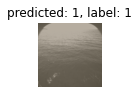

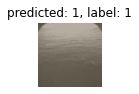

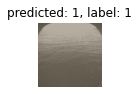

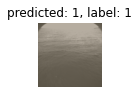

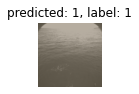

 92%|█████████▏| 11/12 [01:59<00:10, 10.95s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


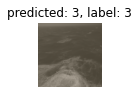

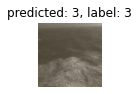

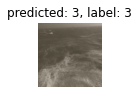

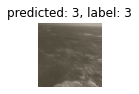

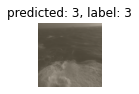

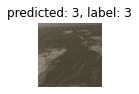

100%|██████████| 12/12 [02:10<00:00, 10.92s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'vgg16_splitted_untrained_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1761/1799
Acurácia: 0.9788771539744302
----------------------


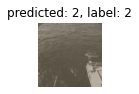

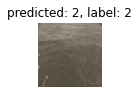

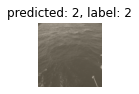

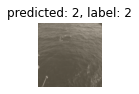

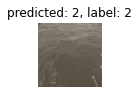

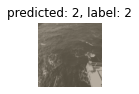

  8%|▊         | 1/12 [00:33<06:05, 33.27s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:866/899
Acurácia: 0.9632925472747497
----------------------


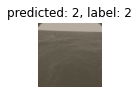

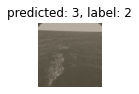

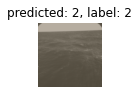

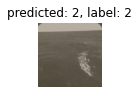

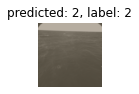

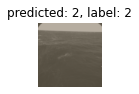

 17%|█▋        | 2/12 [00:47<03:42, 22.28s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:821/898
Acurácia: 0.9142538975501113
----------------------


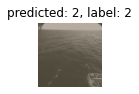

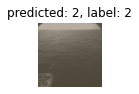

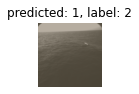

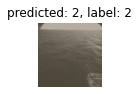

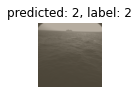

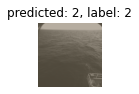

 25%|██▌       | 3/12 [01:00<02:41, 17.95s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:293/300
Acurácia: 0.9766666666666667
----------------------


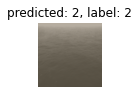

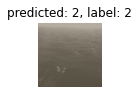

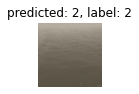

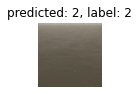

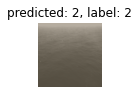

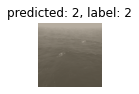

 33%|███▎      | 4/12 [01:06<01:44, 13.07s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:360/361
Acurácia: 0.997229916897507
----------------------


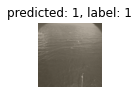

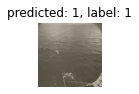

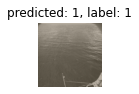

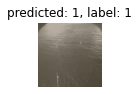

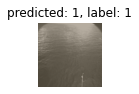

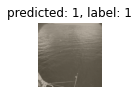

 42%|████▏     | 5/12 [01:12<01:14, 10.69s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


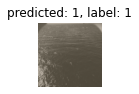

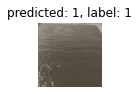

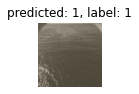

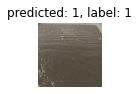

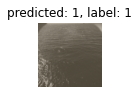

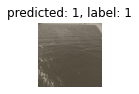

 50%|█████     | 6/12 [01:22<01:01, 10.29s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


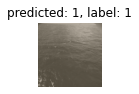

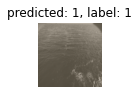

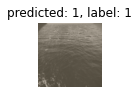

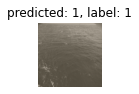

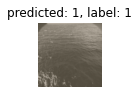

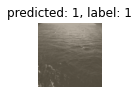

 58%|█████▊    | 7/12 [01:36<00:57, 11.43s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


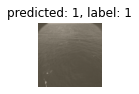

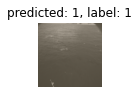

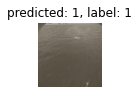

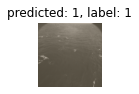

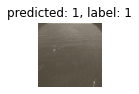

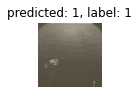

 67%|██████▋   | 8/12 [01:50<00:49, 12.28s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


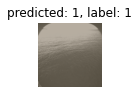

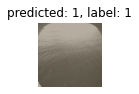

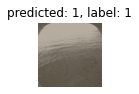

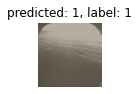

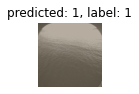

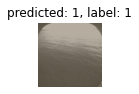

 75%|███████▌  | 9/12 [02:05<00:39, 13.23s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


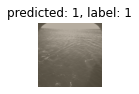

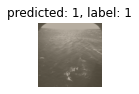

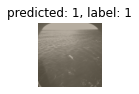

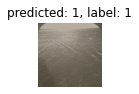

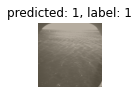

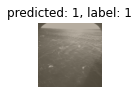

 83%|████████▎ | 10/12 [02:18<00:26, 13.10s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


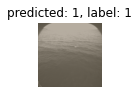

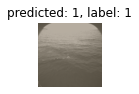

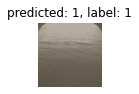

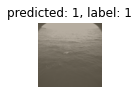

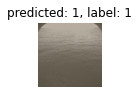

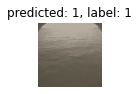

 92%|█████████▏| 11/12 [02:34<00:14, 14.09s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


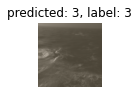

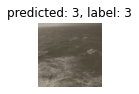

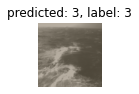

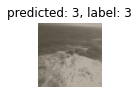

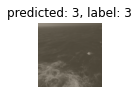

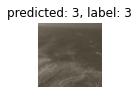

100%|██████████| 12/12 [02:49<00:00, 14.09s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'vgg16_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1780/1799
Acurácia: 0.9894385769872152
----------------------


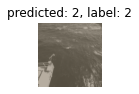

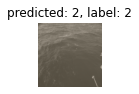

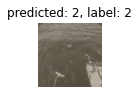

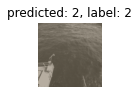

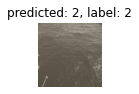

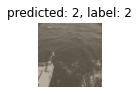

  8%|▊         | 1/12 [00:22<04:02, 22.02s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:861/899
Acurácia: 0.9577308120133482
----------------------


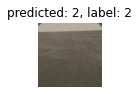

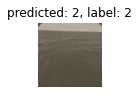

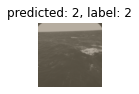

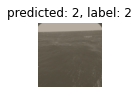

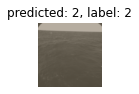

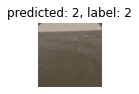

 17%|█▋        | 2/12 [00:34<02:44, 16.46s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:839/898
Acurácia: 0.9342984409799554
----------------------


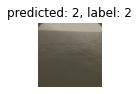

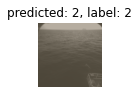

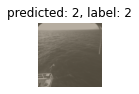

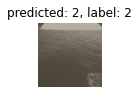

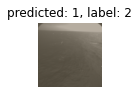

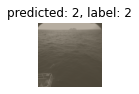

 25%|██▌       | 3/12 [00:46<02:11, 14.56s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:287/300
Acurácia: 0.9566666666666667
----------------------


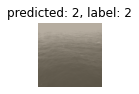

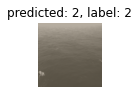

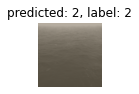

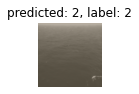

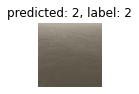

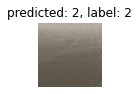

 33%|███▎      | 4/12 [00:52<01:26, 10.83s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


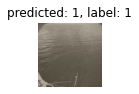

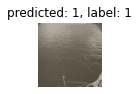

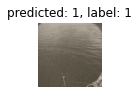

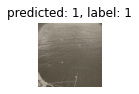

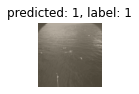

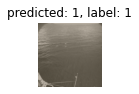

 42%|████▏     | 5/12 [00:58<01:04,  9.15s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


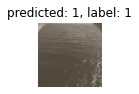

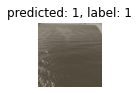

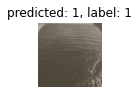

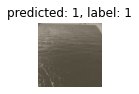

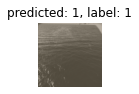

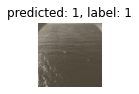

 50%|█████     | 6/12 [01:06<00:53,  8.89s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


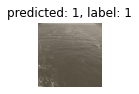

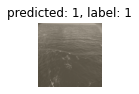

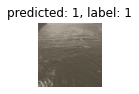

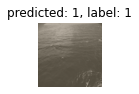

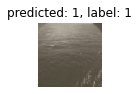

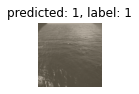

 58%|█████▊    | 7/12 [01:20<00:53, 10.69s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


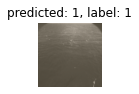

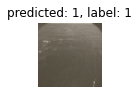

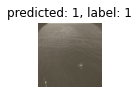

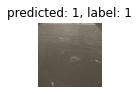

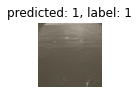

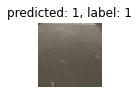

 67%|██████▋   | 8/12 [01:35<00:47, 11.88s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


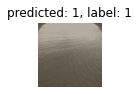

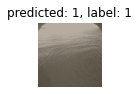

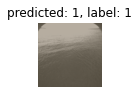

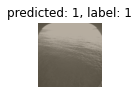

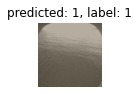

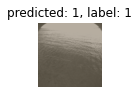

 75%|███████▌  | 9/12 [01:49<00:37, 12.54s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


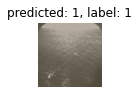

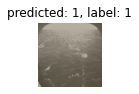

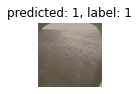

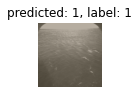

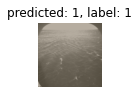

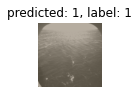

 83%|████████▎ | 10/12 [02:02<00:25, 12.63s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


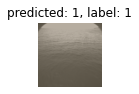

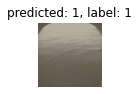

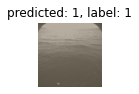

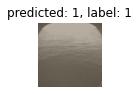

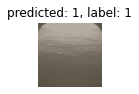

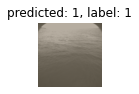

 92%|█████████▏| 11/12 [02:15<00:12, 12.74s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


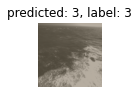

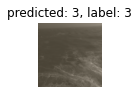

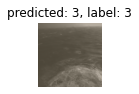

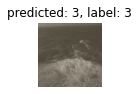

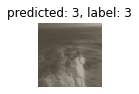

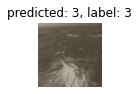

100%|██████████| 12/12 [02:29<00:00, 12.42s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'vgg16_splitted_weighted_loss_tpn')

Device: cpu
Model loaded from resnet34_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1755/1799
Acurácia: 0.9755419677598666
----------------------


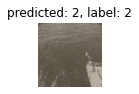

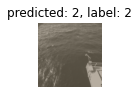

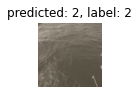

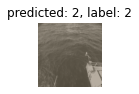

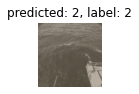

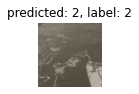

  8%|▊         | 1/12 [03:19<36:33, 199.40s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:896/899
Acurácia: 0.996662958843159
----------------------


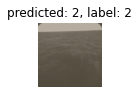

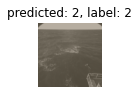

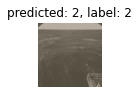

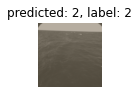

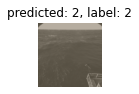

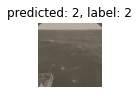

 17%|█▋        | 2/12 [04:59<23:31, 141.16s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:778/898
Acurácia: 0.8663697104677061
----------------------


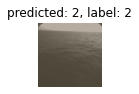

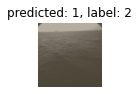

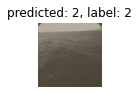

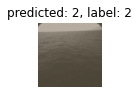

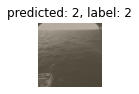

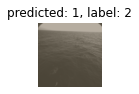

 25%|██▌       | 3/12 [06:38<18:17, 121.92s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:120/300
Acurácia: 0.4
----------------------


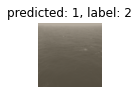

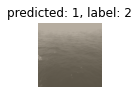

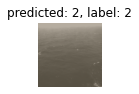

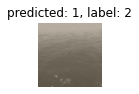

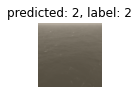

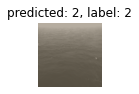

 33%|███▎      | 4/12 [07:12<11:36, 87.12s/it] 

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:354/361
Acurácia: 0.9806094182825484
----------------------


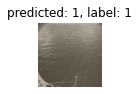

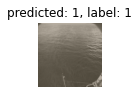

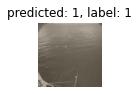

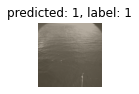

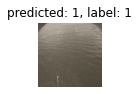

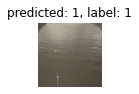

 42%|████▏     | 5/12 [07:54<08:15, 70.81s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:594/599
Acurácia: 0.991652754590985
----------------------


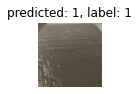

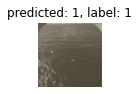

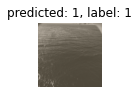

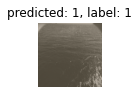

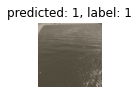

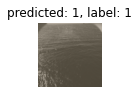

 50%|█████     | 6/12 [09:03<07:01, 70.27s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:792/899
Acurácia: 0.8809788654060067
----------------------


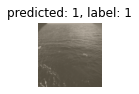

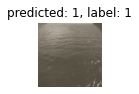

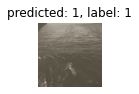

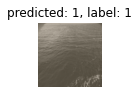

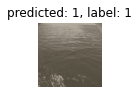

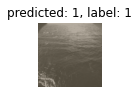

 58%|█████▊    | 7/12 [10:44<06:41, 80.24s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:890/899
Acurácia: 0.9899888765294772
----------------------


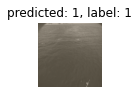

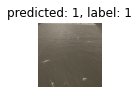

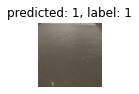

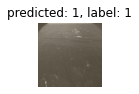

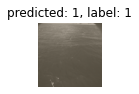

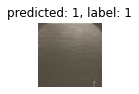

 67%|██████▋   | 8/12 [12:24<05:45, 86.50s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


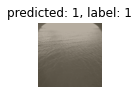

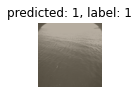

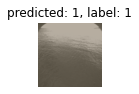

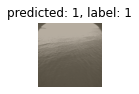

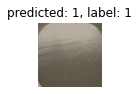

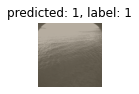

 75%|███████▌  | 9/12 [14:03<04:31, 90.58s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:870/899
Acurácia: 0.967741935483871
----------------------


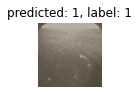

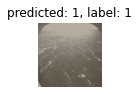

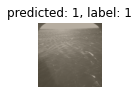

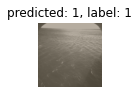

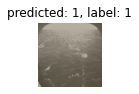

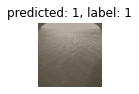

 83%|████████▎ | 10/12 [15:42<03:06, 93.07s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:896/899
Acurácia: 0.996662958843159
----------------------


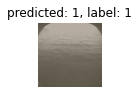

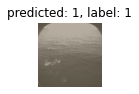

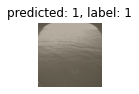

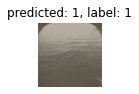

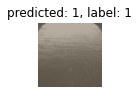

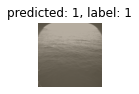

 92%|█████████▏| 11/12 [17:22<01:35, 95.08s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


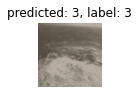

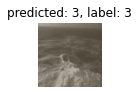

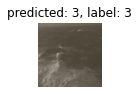

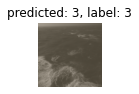

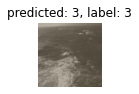

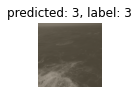

100%|██████████| 12/12 [19:04<00:00, 95.42s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet34_splitted_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1291/1799
Acurácia: 0.7176209005002779
----------------------


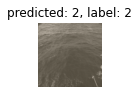

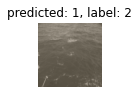

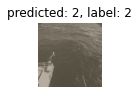

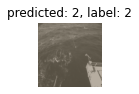

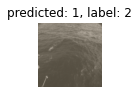

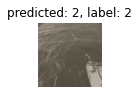

  8%|▊         | 1/12 [00:15<02:47, 15.18s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:837/899
Acurácia: 0.9310344827586207
----------------------


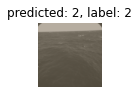

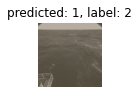

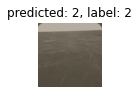

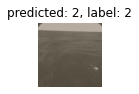

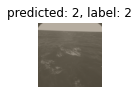

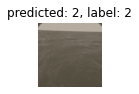

 17%|█▋        | 2/12 [00:21<01:38,  9.86s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:824/898
Acurácia: 0.9175946547884187
----------------------


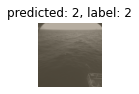

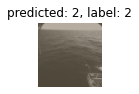

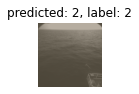

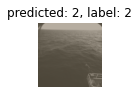

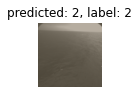

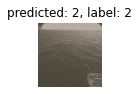

 25%|██▌       | 3/12 [00:27<01:14,  8.22s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:87/300
Acurácia: 0.29
----------------------


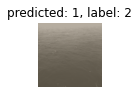

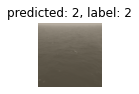

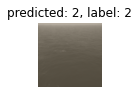

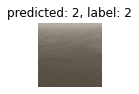

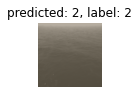

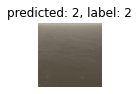

 33%|███▎      | 4/12 [00:30<00:49,  6.19s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:350/361
Acurácia: 0.9695290858725761
----------------------


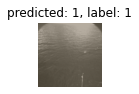

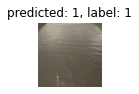

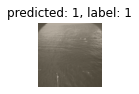

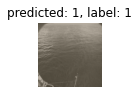

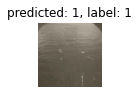

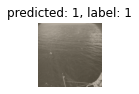

 42%|████▏     | 5/12 [00:34<00:36,  5.21s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:54/599
Acurácia: 0.09015025041736227
----------------------


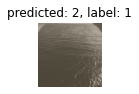

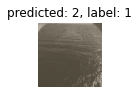

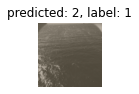

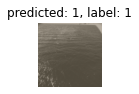

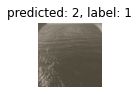

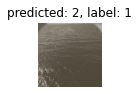

 50%|█████     | 6/12 [00:38<00:30,  5.03s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:788/899
Acurácia: 0.8765294771968855
----------------------


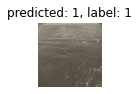

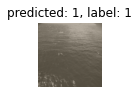

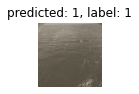

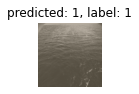

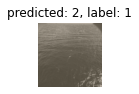

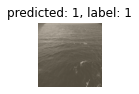

 58%|█████▊    | 7/12 [00:45<00:27,  5.53s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:226/899
Acurácia: 0.25139043381535037
----------------------


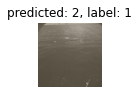

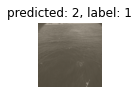

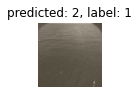

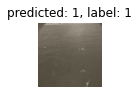

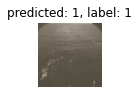

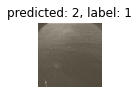

 67%|██████▋   | 8/12 [00:51<00:23,  5.80s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


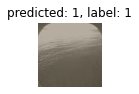

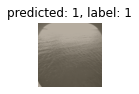

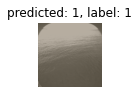

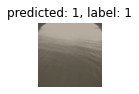

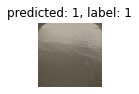

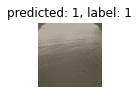

 75%|███████▌  | 9/12 [00:58<00:17,  5.99s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


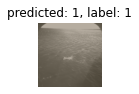

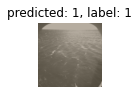

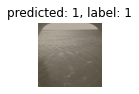

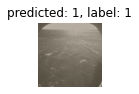

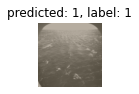

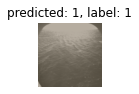

 83%|████████▎ | 10/12 [01:04<00:12,  6.20s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


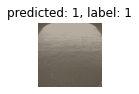

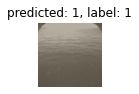

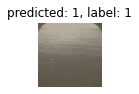

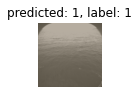

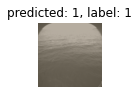

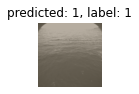

 92%|█████████▏| 11/12 [01:11<00:06,  6.31s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:485/900
Acurácia: 0.5388888888888889
----------------------


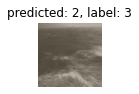

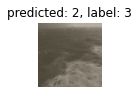

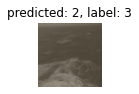

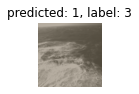

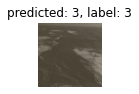

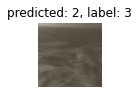

100%|██████████| 12/12 [01:17<00:00,  6.48s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet34_splitted_untrained_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1783/1799
Acurácia: 0.991106170094497
----------------------


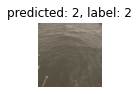

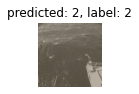

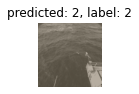

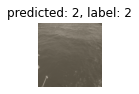

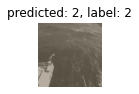

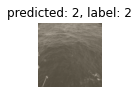

  8%|▊         | 1/12 [00:15<02:48, 15.36s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:895/899
Acurácia: 0.9955506117908788
----------------------


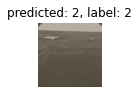

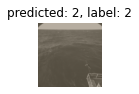

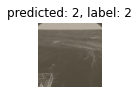

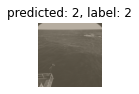

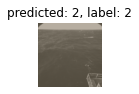

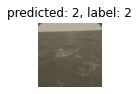

 17%|█▋        | 2/12 [00:21<01:39,  9.91s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:762/898
Acurácia: 0.8485523385300668
----------------------


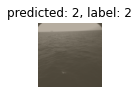

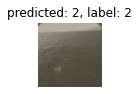

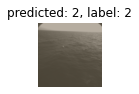

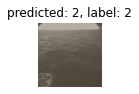

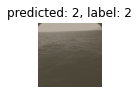

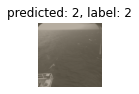

 25%|██▌       | 3/12 [00:27<01:13,  8.18s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:133/300
Acurácia: 0.44333333333333336
----------------------


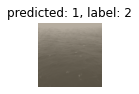

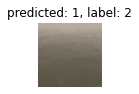

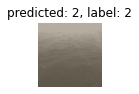

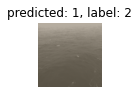

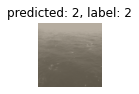

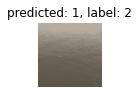

 33%|███▎      | 4/12 [00:30<00:49,  6.16s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:359/361
Acurácia: 0.9944598337950139
----------------------


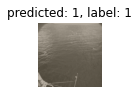

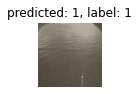

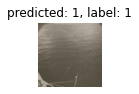

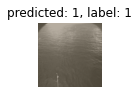

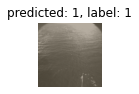

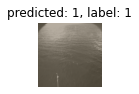

 42%|████▏     | 5/12 [00:34<00:36,  5.19s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:586/599
Acurácia: 0.9782971619365609
----------------------


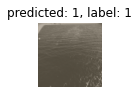

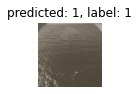

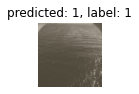

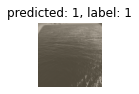

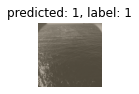

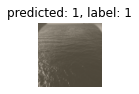

 50%|█████     | 6/12 [00:38<00:30,  5.05s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:778/899
Acurácia: 0.8654060066740823
----------------------


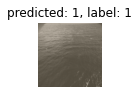

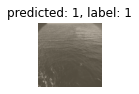

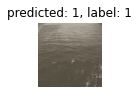

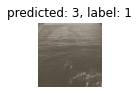

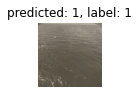

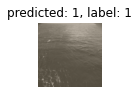

 58%|█████▊    | 7/12 [00:45<00:27,  5.51s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:879/899
Acurácia: 0.9777530589543938
----------------------


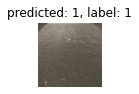

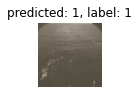

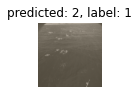

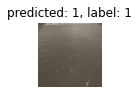

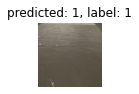

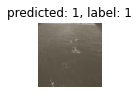

 67%|██████▋   | 8/12 [00:52<00:23,  5.98s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


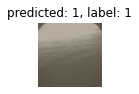

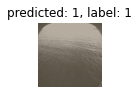

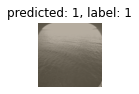

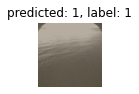

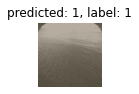

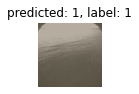

 75%|███████▌  | 9/12 [00:58<00:18,  6.11s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:859/899
Acurácia: 0.9555061179087876
----------------------


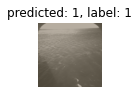

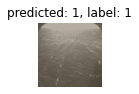

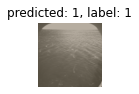

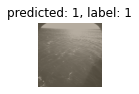

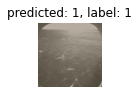

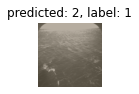

 83%|████████▎ | 10/12 [01:05<00:12,  6.24s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:892/899
Acurácia: 0.9922135706340378
----------------------


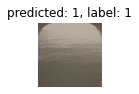

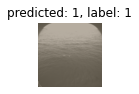

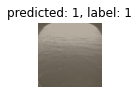

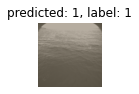

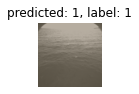

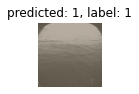

 92%|█████████▏| 11/12 [01:11<00:06,  6.31s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


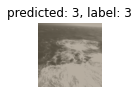

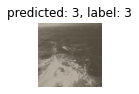

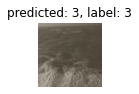

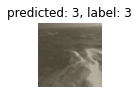

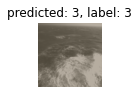

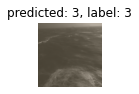

100%|██████████| 12/12 [01:18<00:00,  6.51s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet34_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1787/1799
Acurácia: 0.9933296275708727
----------------------


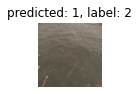

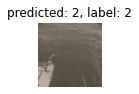

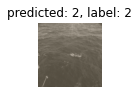

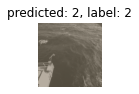

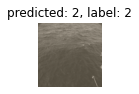

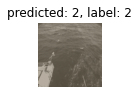

  8%|▊         | 1/12 [00:15<02:48, 15.30s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


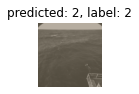

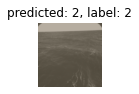

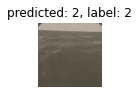

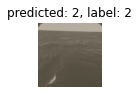

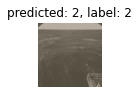

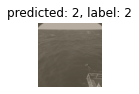

 17%|█▋        | 2/12 [00:21<01:39,  9.92s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:779/898
Acurácia: 0.8674832962138085
----------------------


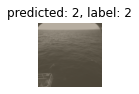

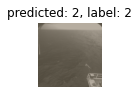

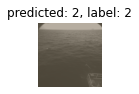

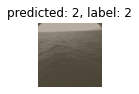

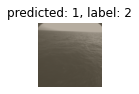

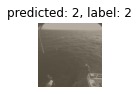

 25%|██▌       | 3/12 [00:27<01:14,  8.27s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:231/300
Acurácia: 0.77
----------------------


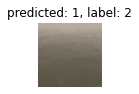

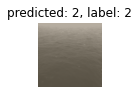

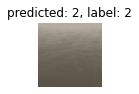

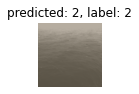

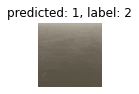

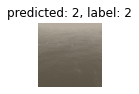

 33%|███▎      | 4/12 [00:31<00:51,  6.47s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:347/361
Acurácia: 0.961218836565097
----------------------


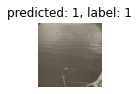

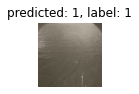

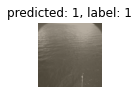

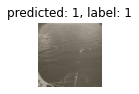

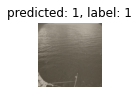

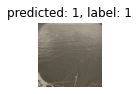

 42%|████▏     | 5/12 [00:35<00:38,  5.48s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:571/599
Acurácia: 0.9532554257095158
----------------------


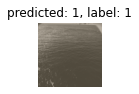

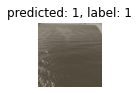

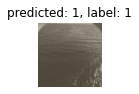

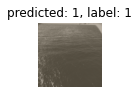

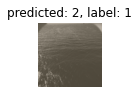

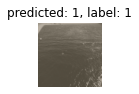

 50%|█████     | 6/12 [00:39<00:31,  5.25s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:694/899
Acurácia: 0.7719688542825361
----------------------


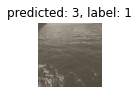

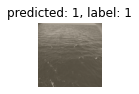

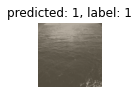

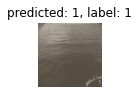

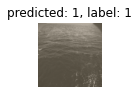

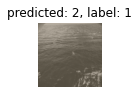

 58%|█████▊    | 7/12 [00:46<00:28,  5.66s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:870/899
Acurácia: 0.967741935483871
----------------------


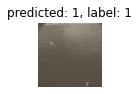

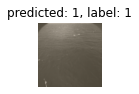

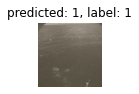

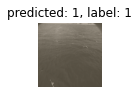

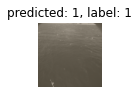

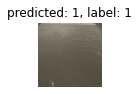

 67%|██████▋   | 8/12 [00:52<00:23,  5.89s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


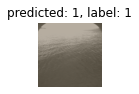

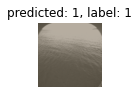

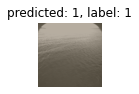

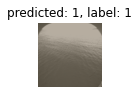

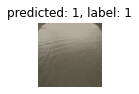

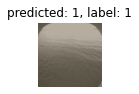

 75%|███████▌  | 9/12 [00:59<00:18,  6.05s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:849/899
Acurácia: 0.9443826473859844
----------------------


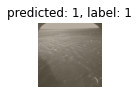

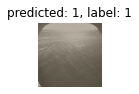

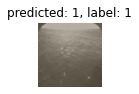

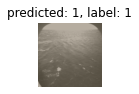

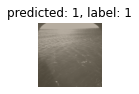

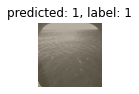

 83%|████████▎ | 10/12 [01:06<00:12,  6.40s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:887/899
Acurácia: 0.9866518353726362
----------------------


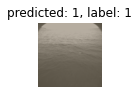

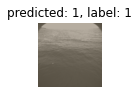

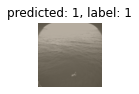

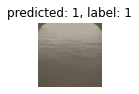

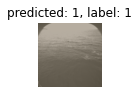

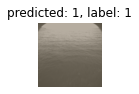

 92%|█████████▏| 11/12 [01:12<00:06,  6.41s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


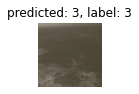

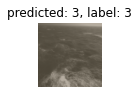

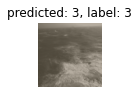

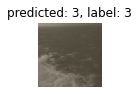

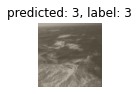

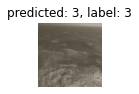

100%|██████████| 12/12 [01:19<00:00,  6.61s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet34_splitted_weighted_loss_tpn')

Device: cpu
Model loaded from resnet50_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1729/1799
Acurácia: 0.9610894941634242
----------------------


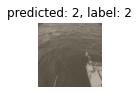

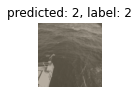

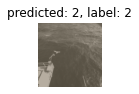

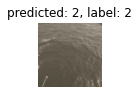

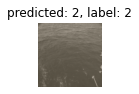

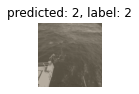

  8%|▊         | 1/12 [07:55<1:27:05, 475.08s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:891/899
Acurácia: 0.9911012235817576
----------------------


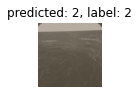

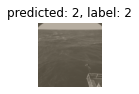

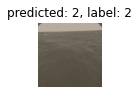

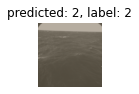

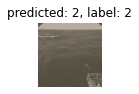

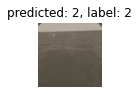

 17%|█▋        | 2/12 [11:54<56:03, 336.34s/it]  

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:896/898
Acurácia: 0.9977728285077951
----------------------


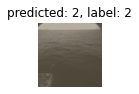

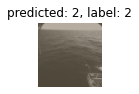

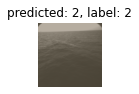

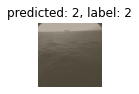

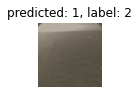

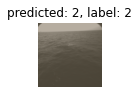

 25%|██▌       | 3/12 [15:49<43:30, 290.06s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:217/300
Acurácia: 0.7233333333333334
----------------------


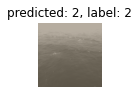

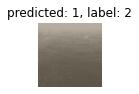

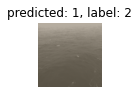

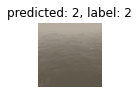

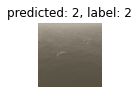

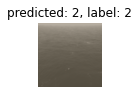

 33%|███▎      | 4/12 [17:10<27:39, 207.44s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:346/361
Acurácia: 0.9584487534626038
----------------------


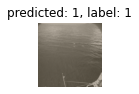

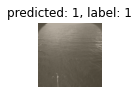

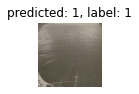

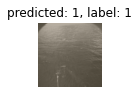

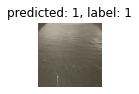

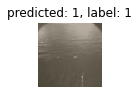

 42%|████▏     | 5/12 [18:45<19:28, 166.91s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:597/599
Acurácia: 0.996661101836394
----------------------


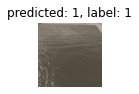

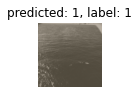

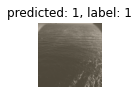

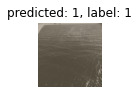

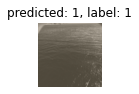

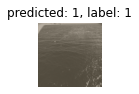

 50%|█████     | 6/12 [21:25<16:28, 164.79s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:888/899
Acurácia: 0.9877641824249166
----------------------


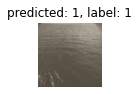

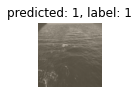

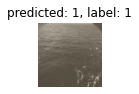

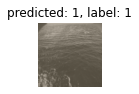

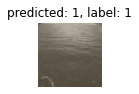

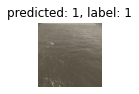

 58%|█████▊    | 7/12 [25:24<15:44, 188.85s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:870/899
Acurácia: 0.967741935483871
----------------------


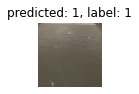

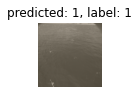

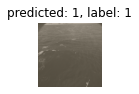

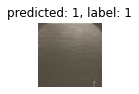

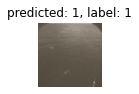

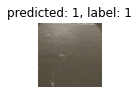

 67%|██████▋   | 8/12 [29:22<13:38, 204.53s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


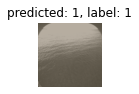

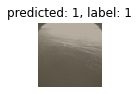

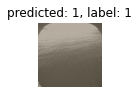

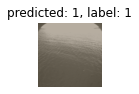

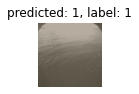

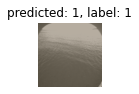

 75%|███████▌  | 9/12 [33:22<10:46, 215.58s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:892/899
Acurácia: 0.9922135706340378
----------------------


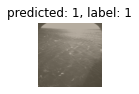

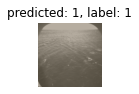

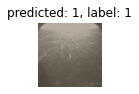

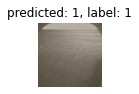

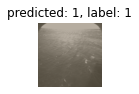

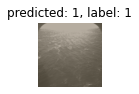

 83%|████████▎ | 10/12 [37:18<07:24, 222.08s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


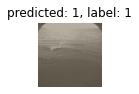

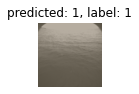

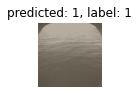

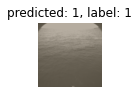

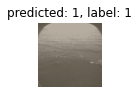

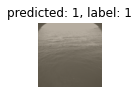

 92%|█████████▏| 11/12 [41:18<03:47, 227.51s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:897/900
Acurácia: 0.9966666666666667
----------------------


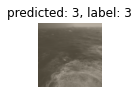

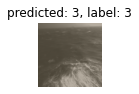

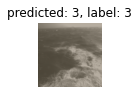

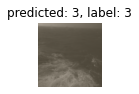

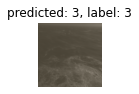

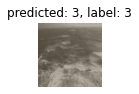

100%|██████████| 12/12 [45:19<00:00, 226.60s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet50_splitted_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1789/1799
Acurácia: 0.9944413563090606
----------------------


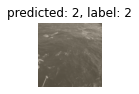

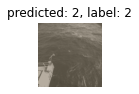

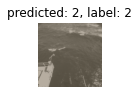

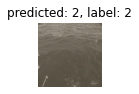

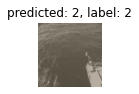

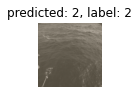

  8%|▊         | 1/12 [00:53<09:46, 53.35s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:896/899
Acurácia: 0.996662958843159
----------------------


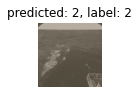

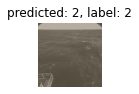

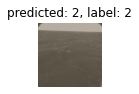

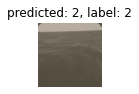

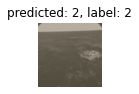

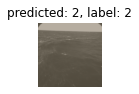

 17%|█▋        | 2/12 [01:09<05:16, 31.66s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:868/898
Acurácia: 0.9665924276169265
----------------------


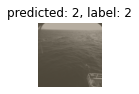

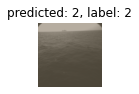

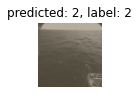

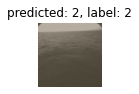

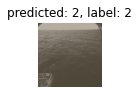

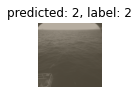

 25%|██▌       | 3/12 [01:25<03:38, 24.29s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:149/300
Acurácia: 0.49666666666666665
----------------------


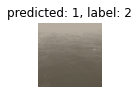

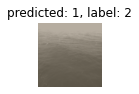

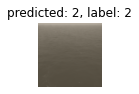

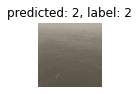

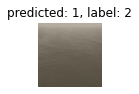

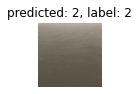

 33%|███▎      | 4/12 [01:32<02:18, 17.34s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:360/361
Acurácia: 0.997229916897507
----------------------


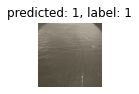

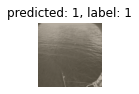

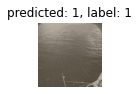

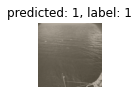

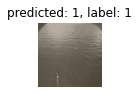

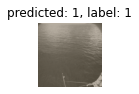

 42%|████▏     | 5/12 [01:40<01:38, 14.04s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:598/599
Acurácia: 0.998330550918197
----------------------


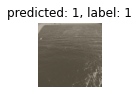

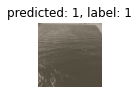

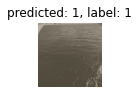

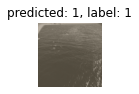

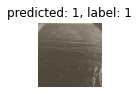

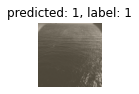

 50%|█████     | 6/12 [01:52<01:19, 13.32s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:837/899
Acurácia: 0.9310344827586207
----------------------


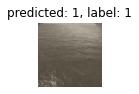

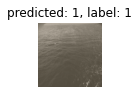

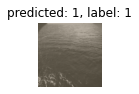

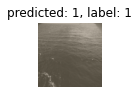

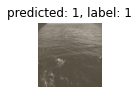

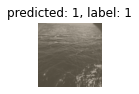

 58%|█████▊    | 7/12 [02:09<01:13, 14.64s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:850/899
Acurácia: 0.9454949944382648
----------------------


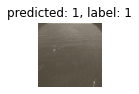

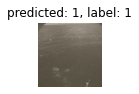

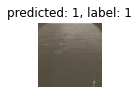

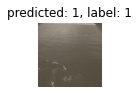

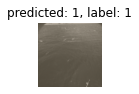

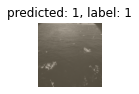

 67%|██████▋   | 8/12 [02:25<01:00, 15.15s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:868/899
Acurácia: 0.9655172413793104
----------------------


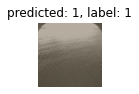

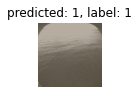

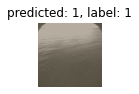

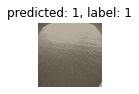

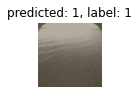

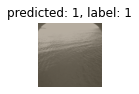

 75%|███████▌  | 9/12 [02:42<00:46, 15.50s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


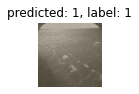

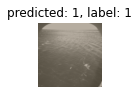

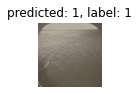

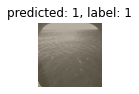

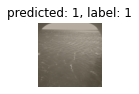

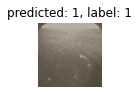

 83%|████████▎ | 10/12 [02:58<00:31, 15.71s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


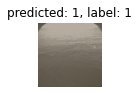

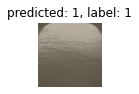

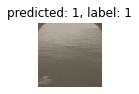

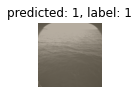

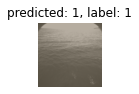

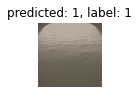

 92%|█████████▏| 11/12 [03:15<00:16, 16.13s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:899/900
Acurácia: 0.9988888888888889
----------------------


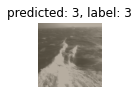

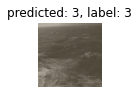

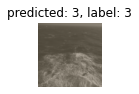

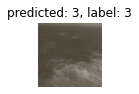

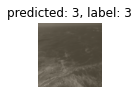

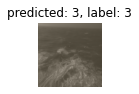

100%|██████████| 12/12 [03:32<00:00, 17.73s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet152_splitted_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1761/1799
Acurácia: 0.9788771539744302
----------------------


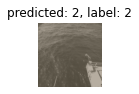

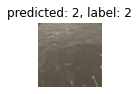

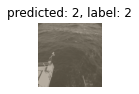

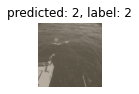

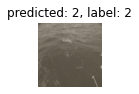

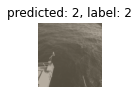

  8%|▊         | 1/12 [00:24<04:30, 24.60s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:866/899
Acurácia: 0.9632925472747497
----------------------


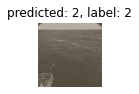

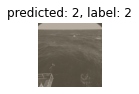

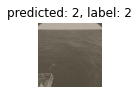

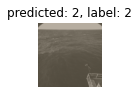

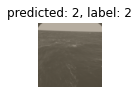

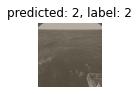

 17%|█▋        | 2/12 [00:36<02:51, 17.18s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


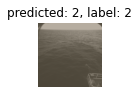

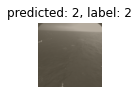

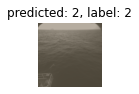

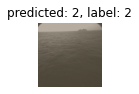

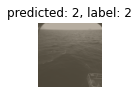

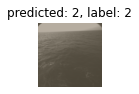

 25%|██▌       | 3/12 [00:48<02:13, 14.82s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:269/300
Acurácia: 0.8966666666666666
----------------------


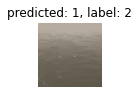

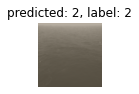

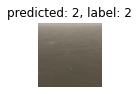

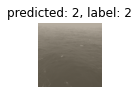

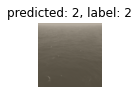

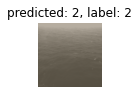

 33%|███▎      | 4/12 [00:53<01:26, 10.86s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:13/361
Acurácia: 0.036011080332409975
----------------------


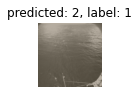

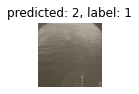

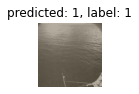

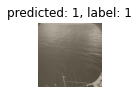

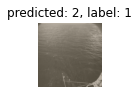

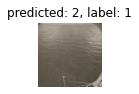

 42%|████▏     | 5/12 [00:59<01:04,  9.26s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:2/599
Acurácia: 0.00333889816360601
----------------------


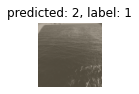

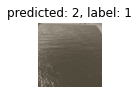

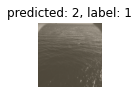

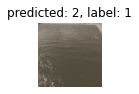

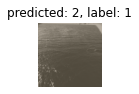

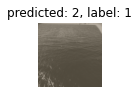

 50%|█████     | 6/12 [01:08<00:53,  8.93s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:104/899
Acurácia: 0.11568409343715239
----------------------


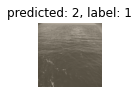

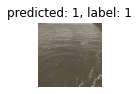

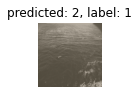

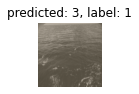

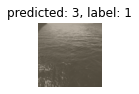

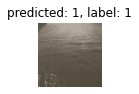

 58%|█████▊    | 7/12 [01:20<00:49,  9.93s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:2/899
Acurácia: 0.002224694104560623
----------------------


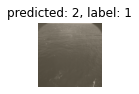

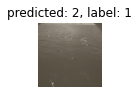

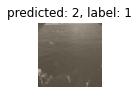

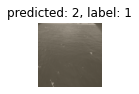

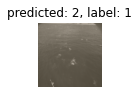

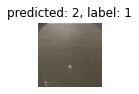

 67%|██████▋   | 8/12 [01:32<00:42, 10.57s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:649/899
Acurácia: 0.7219132369299222
----------------------


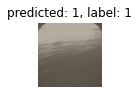

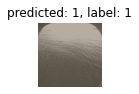

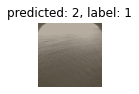

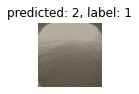

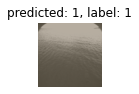

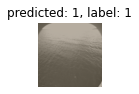

 75%|███████▌  | 9/12 [01:43<00:33, 11.00s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:479/899
Acurácia: 0.5328142380422692
----------------------


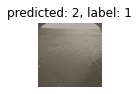

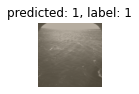

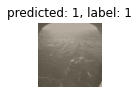

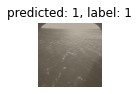

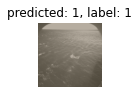

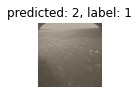

 83%|████████▎ | 10/12 [01:56<00:22, 11.34s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:721/899
Acurácia: 0.8020022246941045
----------------------


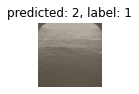

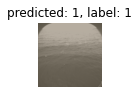

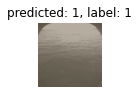

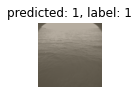

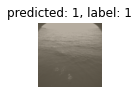

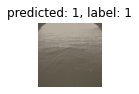

 92%|█████████▏| 11/12 [02:08<00:11, 11.62s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:188/900
Acurácia: 0.2088888888888889
----------------------


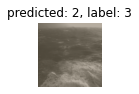

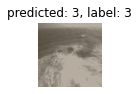

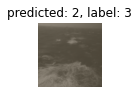

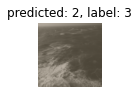

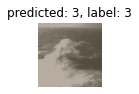

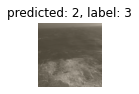

100%|██████████| 12/12 [02:20<00:00, 11.72s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet152_splitted_untrained_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1796/1799
Acurácia: 0.9983324068927182
----------------------


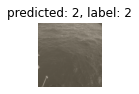

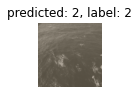

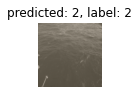

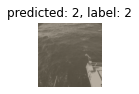

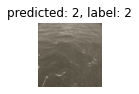

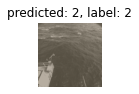

  8%|▊         | 1/12 [00:24<04:34, 24.95s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


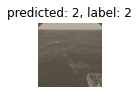

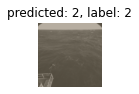

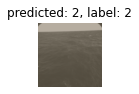

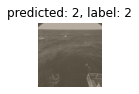

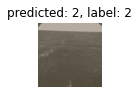

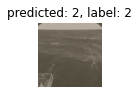

 17%|█▋        | 2/12 [00:36<02:50, 17.06s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


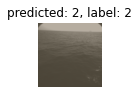

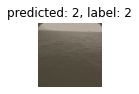

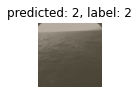

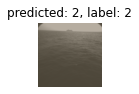

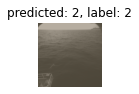

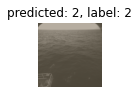

 25%|██▌       | 3/12 [00:48<02:11, 14.63s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


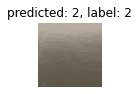

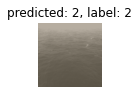

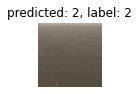

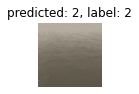

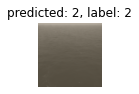

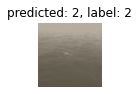

 33%|███▎      | 4/12 [00:53<01:26, 10.76s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:2/361
Acurácia: 0.00554016620498615
----------------------


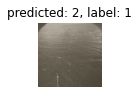

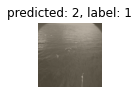

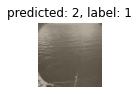

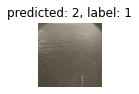

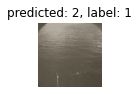

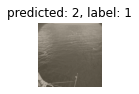

 42%|████▏     | 5/12 [00:58<01:02,  8.90s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:0/599
Acurácia: 0.0
----------------------


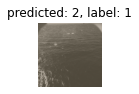

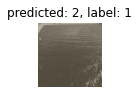

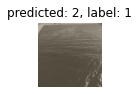

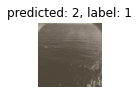

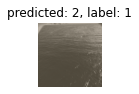

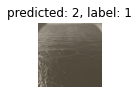

 50%|█████     | 6/12 [01:06<00:52,  8.71s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:7/899
Acurácia: 0.00778642936596218
----------------------


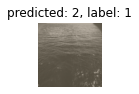

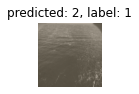

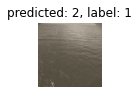

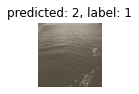

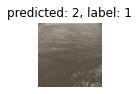

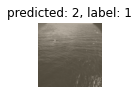

 58%|█████▊    | 7/12 [01:18<00:48,  9.76s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:0/899
Acurácia: 0.0
----------------------


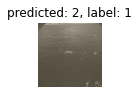

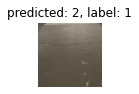

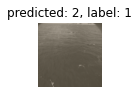

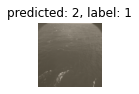

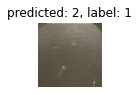

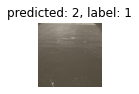

 67%|██████▋   | 8/12 [01:30<00:41, 10.43s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:13/899
Acurácia: 0.014460511679644048
----------------------


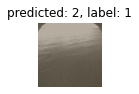

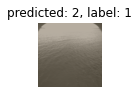

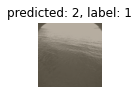

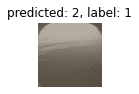

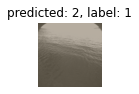

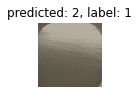

 75%|███████▌  | 9/12 [01:42<00:32, 10.92s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:43/899
Acurácia: 0.047830923248053395
----------------------


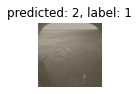

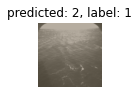

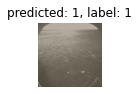

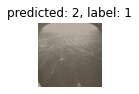

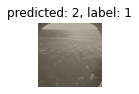

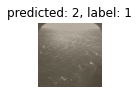

 83%|████████▎ | 10/12 [01:54<00:22, 11.25s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:10/899
Acurácia: 0.011123470522803115
----------------------


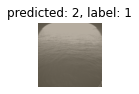

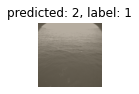

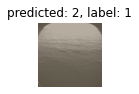

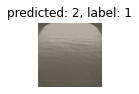

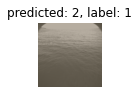

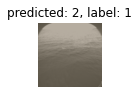

 92%|█████████▏| 11/12 [02:07<00:11, 11.56s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:0/900
Acurácia: 0.0
----------------------


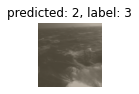

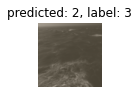

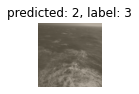

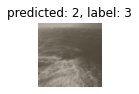

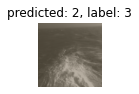

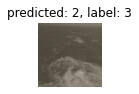

100%|██████████| 12/12 [02:18<00:00, 11.57s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet152_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 

Num de acertos/Num de samples:1798/1799
Acurácia: 0.9994441356309061
----------------------


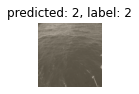

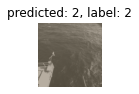

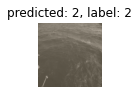

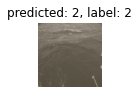

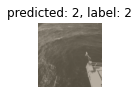

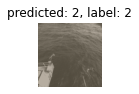

  8%|▊         | 1/12 [00:25<04:40, 25.49s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


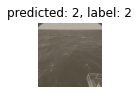

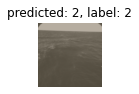

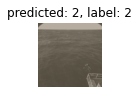

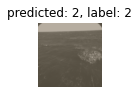

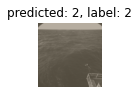

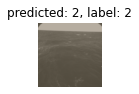

 17%|█▋        | 2/12 [00:36<02:52, 17.21s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:886/898
Acurácia: 0.9866369710467706
----------------------


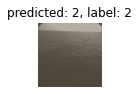

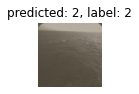

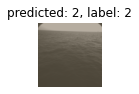

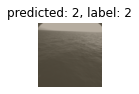

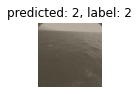

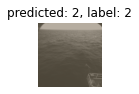

 25%|██▌       | 3/12 [00:48<02:11, 14.56s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:203/300
Acurácia: 0.6766666666666666
----------------------


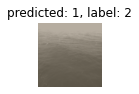

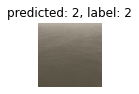

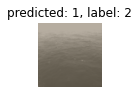

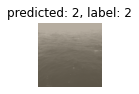

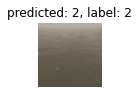

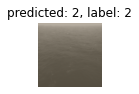

 33%|███▎      | 4/12 [00:53<01:25, 10.72s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


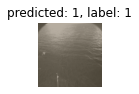

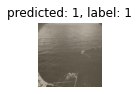

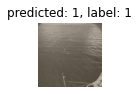

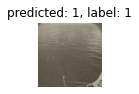

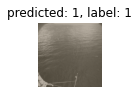

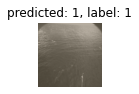

 42%|████▏     | 5/12 [00:58<01:02,  8.86s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:582/599
Acurácia: 0.9716193656093489
----------------------


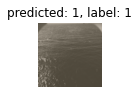

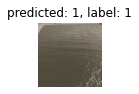

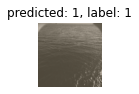

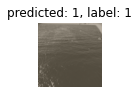

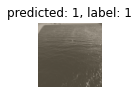

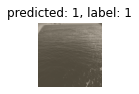

 50%|█████     | 6/12 [01:07<00:53,  8.96s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:679/899
Acurácia: 0.7552836484983315
----------------------


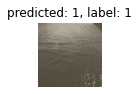

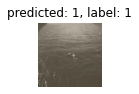

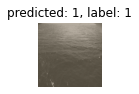

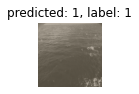

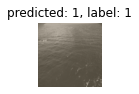

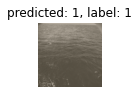

 58%|█████▊    | 7/12 [01:19<00:49,  9.90s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:681/899
Acurácia: 0.7575083426028921
----------------------


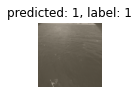

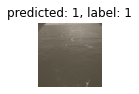

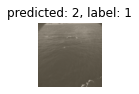

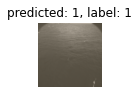

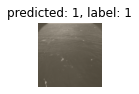

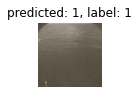

 67%|██████▋   | 8/12 [01:31<00:42, 10.51s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:879/899
Acurácia: 0.9777530589543938
----------------------


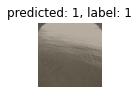

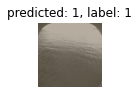

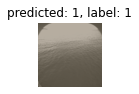

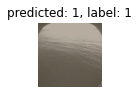

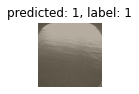

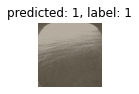

 75%|███████▌  | 9/12 [01:43<00:32, 10.96s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


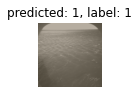

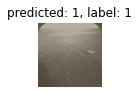

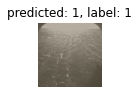

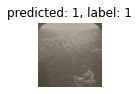

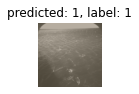

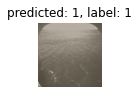

 83%|████████▎ | 10/12 [01:55<00:22, 11.44s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


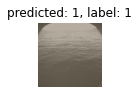

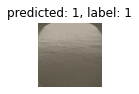

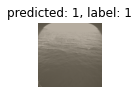

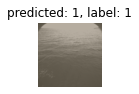

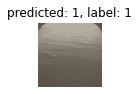

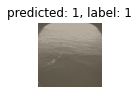

 92%|█████████▏| 11/12 [02:07<00:11, 11.56s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


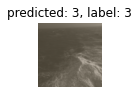

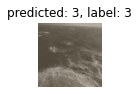

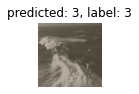

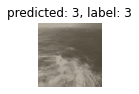

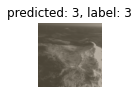

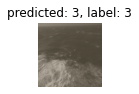

100%|██████████| 12/12 [02:19<00:00, 11.64s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]
test_model(datasets, 'resnet152_splitted_weighted_loss_tpn')

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_pretrained_leave_out_600.


  0%|          | 0/6 [00:00<?, ?it/s]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1756/1798
Acurácia: 0.9766407119021134
----------------------


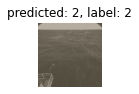

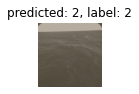

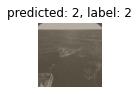

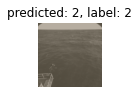

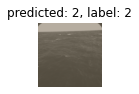

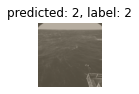

 17%|█▋        | 1/6 [02:24<12:03, 144.74s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 



In [ ]:
datasets = ['AA_2015_2015-03-05_10-35-00_12Hz', 'AA_2015_2015-05-15_09-00-00_12Hz', 'BS_2011_2011-10-04_15-30-00_12Hz', 'BS_2013_2013-09-22_13-00-01_10Hz',
            'BS_2013_2013-09-30_10-20-01_12Hz', 'LJ_2018_2018-01-03_09-39-38_10Hz']
test_model(datasets, 'vgg16_pretrained_leave_out_600')

### Metrics

In [ ]:
def test_model_metrics(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  y_labels = []
  y_pred = []

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '_2058_224.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            y_labels += [int(labels[i]) for i in range(labels.shape[0])]
            y_pred += [int(preds[i]) for i in range(preds.shape[0])]

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

  return y_labels, y_pred

#### VGG16

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Model loaded from vgg16_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1798/1799
Acurácia: 0.9994441356309061
----------------------


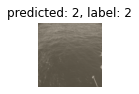

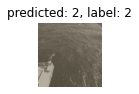

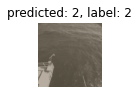

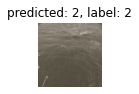

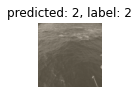

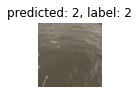

  8%|▊         | 1/12 [00:22<04:12, 22.95s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


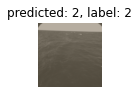

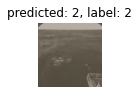

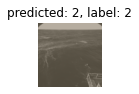

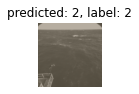

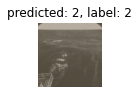

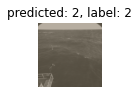

 17%|█▋        | 2/12 [00:35<02:45, 16.56s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


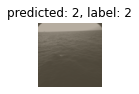

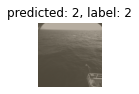

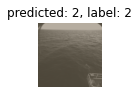

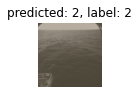

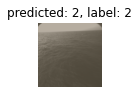

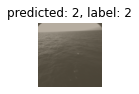

 25%|██▌       | 3/12 [00:48<02:14, 14.93s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


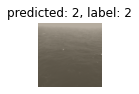

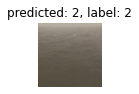

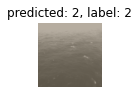

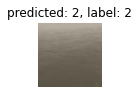

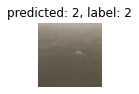

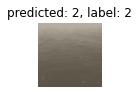

 33%|███▎      | 4/12 [00:53<01:29, 11.25s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


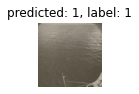

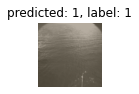

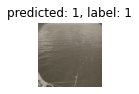

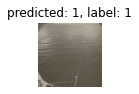

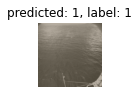

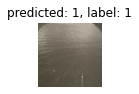

 42%|████▏     | 5/12 [00:59<01:05,  9.33s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


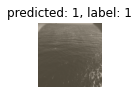

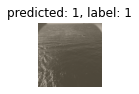

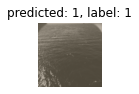

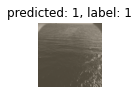

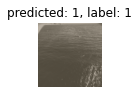

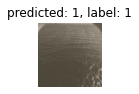

 50%|█████     | 6/12 [01:08<00:54,  9.12s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


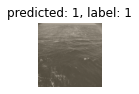

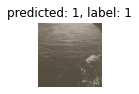

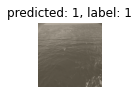

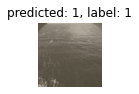

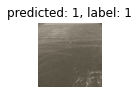

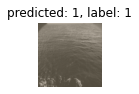

 58%|█████▊    | 7/12 [01:20<00:51, 10.28s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


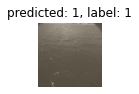

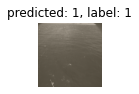

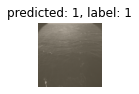

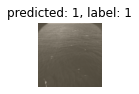

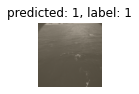

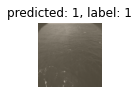

 67%|██████▋   | 8/12 [01:33<00:44, 11.04s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


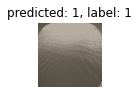

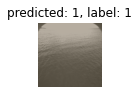

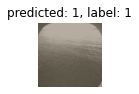

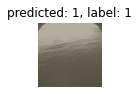

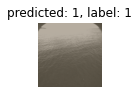

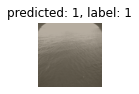

 75%|███████▌  | 9/12 [01:45<00:34, 11.40s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


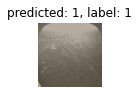

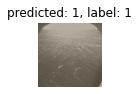

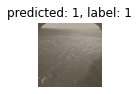

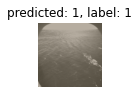

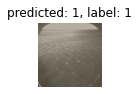

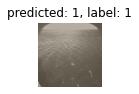

 83%|████████▎ | 10/12 [01:58<00:23, 11.82s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


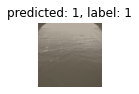

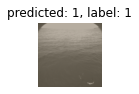

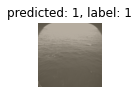

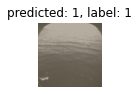

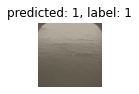

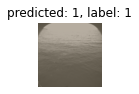

 92%|█████████▏| 11/12 [02:11<00:12, 12.06s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


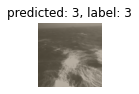

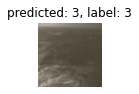

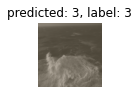

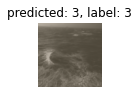

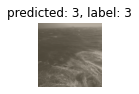

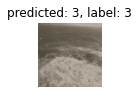

100%|██████████| 12/12 [02:23<00:00, 11.99s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_tpn')

              precision    recall  f1-score   support

           1    1.00000   1.00000   1.00000      5455
           2    1.00000   0.99974   0.99987      3896
           3    0.99889   1.00000   0.99944       900

    accuracy                        0.99990     10251
   macro avg    0.99963   0.99991   0.99977     10251
weighted avg    0.99990   0.99990   0.99990     10251



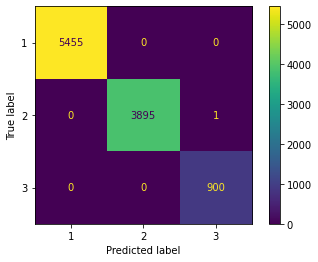

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1796/1799
Acurácia: 0.9983324068927182
----------------------


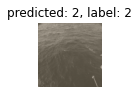

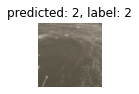

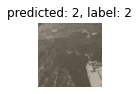

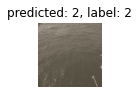

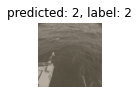

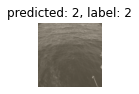

  8%|▊         | 1/12 [00:23<04:18, 23.47s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


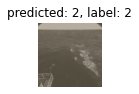

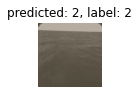

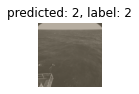

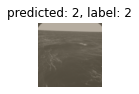

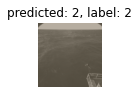

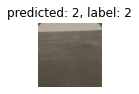

 17%|█▋        | 2/12 [00:35<02:48, 16.85s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


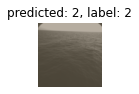

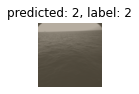

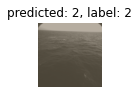

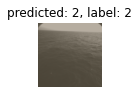

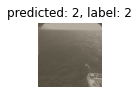

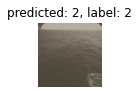

 25%|██▌       | 3/12 [00:48<02:13, 14.88s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


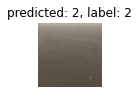

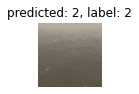

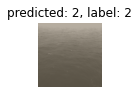

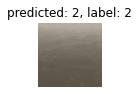

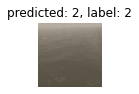

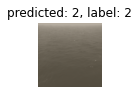

 33%|███▎      | 4/12 [00:53<01:27, 10.96s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


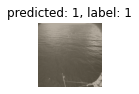

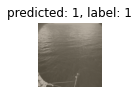

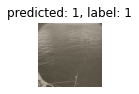

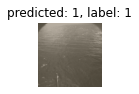

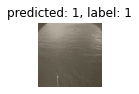

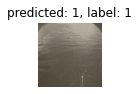

 42%|████▏     | 5/12 [00:58<01:03,  9.04s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:597/599
Acurácia: 0.996661101836394
----------------------


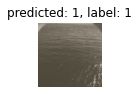

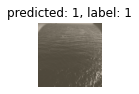

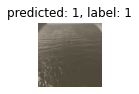

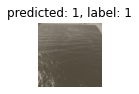

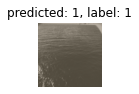

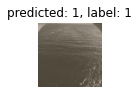

 50%|█████     | 6/12 [01:07<00:53,  8.95s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


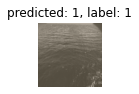

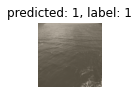

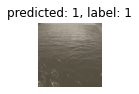

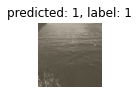

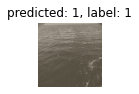

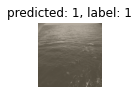

 58%|█████▊    | 7/12 [01:20<00:50, 10.13s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:894/899
Acurácia: 0.9944382647385984
----------------------


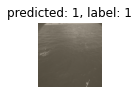

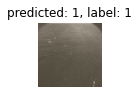

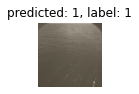

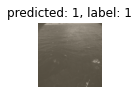

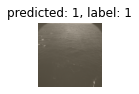

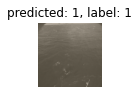

 67%|██████▋   | 8/12 [01:33<00:44, 11.03s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


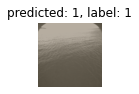

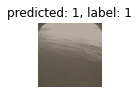

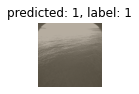

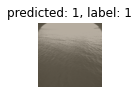

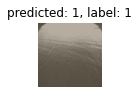

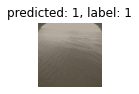

 75%|███████▌  | 9/12 [01:45<00:34, 11.56s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


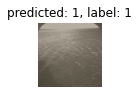

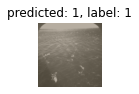

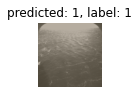

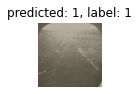

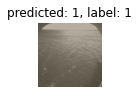

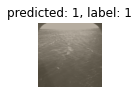

 83%|████████▎ | 10/12 [01:58<00:23, 11.89s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


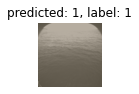

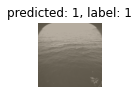

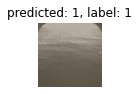

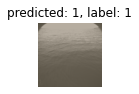

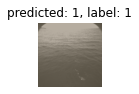

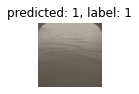

 92%|█████████▏| 11/12 [02:11<00:12, 12.14s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


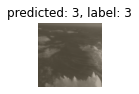

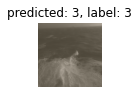

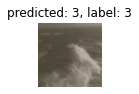

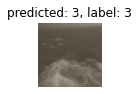

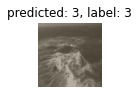

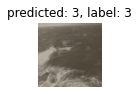

100%|██████████| 12/12 [02:24<00:00, 12.05s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_untrained_tpn')

              precision    recall  f1-score   support

           1    0.99963   0.99872   0.99917      5455
           2    0.99821   0.99923   0.99872      3896
           3    0.99889   1.00000   0.99944       900

    accuracy                        0.99902     10251
   macro avg    0.99891   0.99932   0.99911     10251
weighted avg    0.99903   0.99902   0.99902     10251



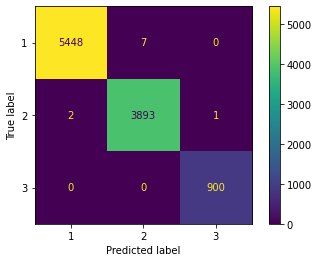

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1761/1799
Acurácia: 0.9788771539744302
----------------------


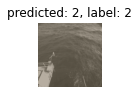

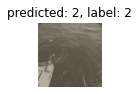

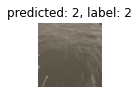

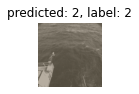

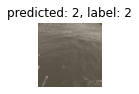

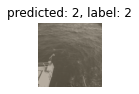

  8%|▊         | 1/12 [00:23<04:22, 23.85s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:873/899
Acurácia: 0.9710789766407119
----------------------


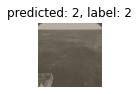

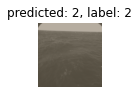

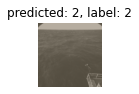

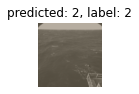

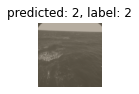

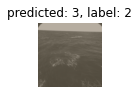

 17%|█▋        | 2/12 [00:36<02:51, 17.13s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:824/898
Acurácia: 0.9175946547884187
----------------------


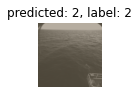

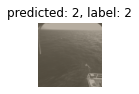

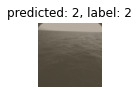

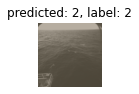

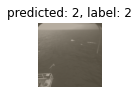

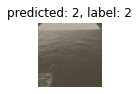

 25%|██▌       | 3/12 [00:48<02:15, 15.05s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:290/300
Acurácia: 0.9666666666666667
----------------------


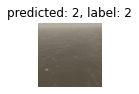

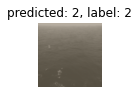

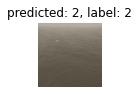

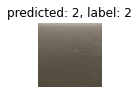

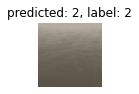

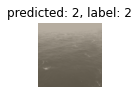

 33%|███▎      | 4/12 [00:53<01:28, 11.08s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


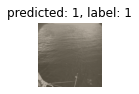

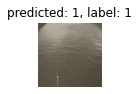

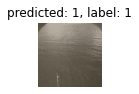

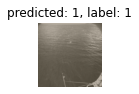

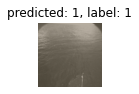

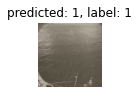

 42%|████▏     | 5/12 [00:59<01:04,  9.15s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


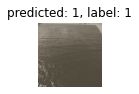

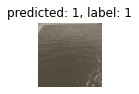

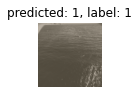

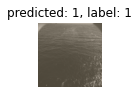

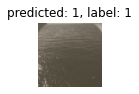

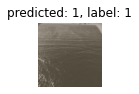

 50%|█████     | 6/12 [01:08<00:54,  9.04s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


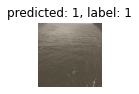

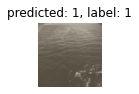

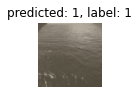

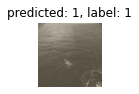

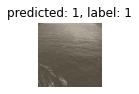

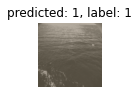

 58%|█████▊    | 7/12 [01:21<00:51, 10.31s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


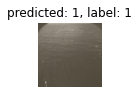

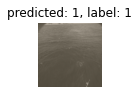

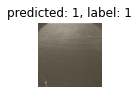

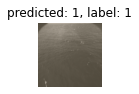

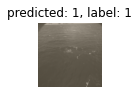

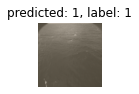

 67%|██████▋   | 8/12 [01:34<00:44, 11.11s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


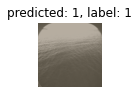

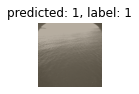

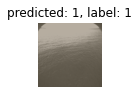

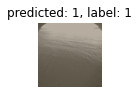

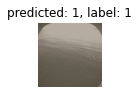

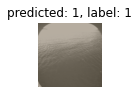

 75%|███████▌  | 9/12 [01:47<00:35, 11.68s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


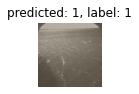

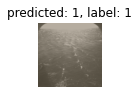

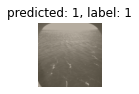

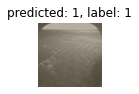

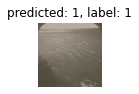

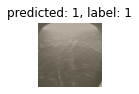

 83%|████████▎ | 10/12 [02:00<00:24, 12.26s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


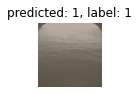

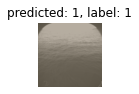

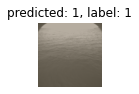

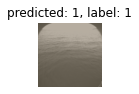

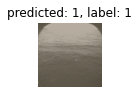

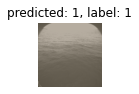

 92%|█████████▏| 11/12 [02:13<00:12, 12.41s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


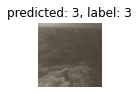

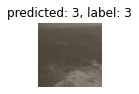

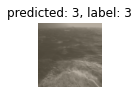

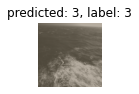

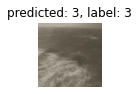

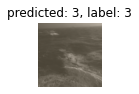

100%|██████████| 12/12 [02:25<00:00, 12.14s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_weighted_oversample_tpn')

              precision    recall  f1-score   support

           1    0.97689   0.99982   0.98822      5455
           2    0.99973   0.96201   0.98051      3896
           3    0.97933   1.00000   0.98955       900

    accuracy                        0.98546     10251
   macro avg    0.98532   0.98728   0.98610     10251
weighted avg    0.98579   0.98546   0.98541     10251



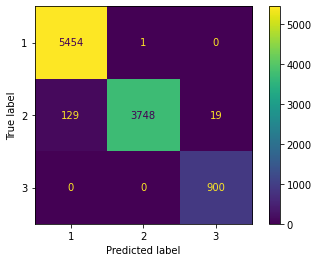

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1780/1799
Acurácia: 0.9894385769872152
----------------------


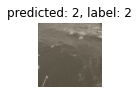

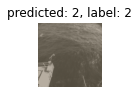

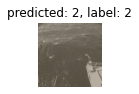

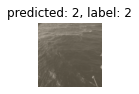

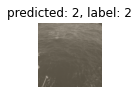

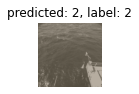

  8%|▊         | 1/12 [00:23<04:22, 23.84s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:861/899
Acurácia: 0.9577308120133482
----------------------


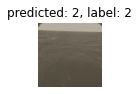

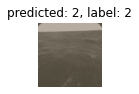

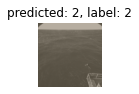

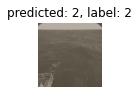

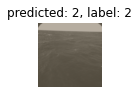

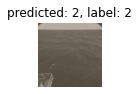

 17%|█▋        | 2/12 [00:36<02:51, 17.15s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:832/898
Acurácia: 0.9265033407572383
----------------------


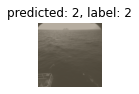

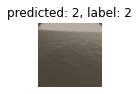

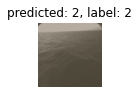

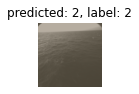

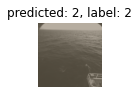

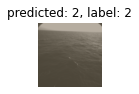

 25%|██▌       | 3/12 [00:48<02:15, 15.06s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:289/300
Acurácia: 0.9633333333333334
----------------------


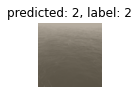

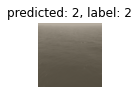

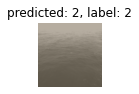

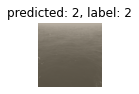

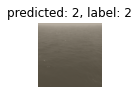

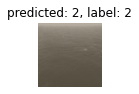

 33%|███▎      | 4/12 [00:53<01:28, 11.09s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


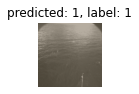

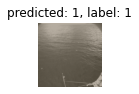

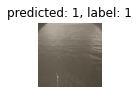

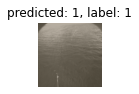

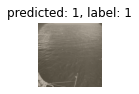

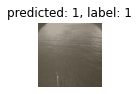

 42%|████▏     | 5/12 [00:59<01:04,  9.15s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


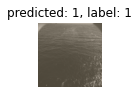

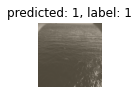

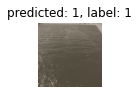

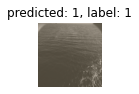

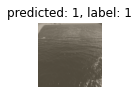

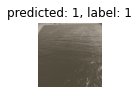

 50%|█████     | 6/12 [01:08<00:54,  9.08s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


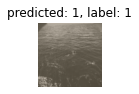

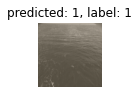

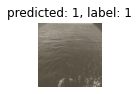

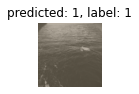

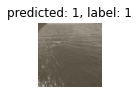

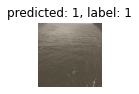

 58%|█████▊    | 7/12 [01:21<00:51, 10.32s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


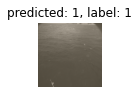

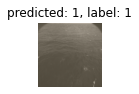

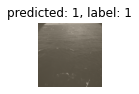

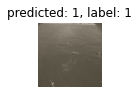

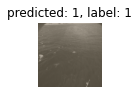

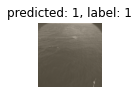

 67%|██████▋   | 8/12 [01:34<00:45, 11.35s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


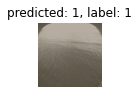

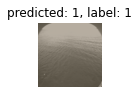

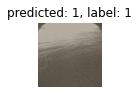

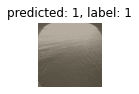

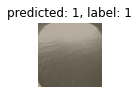

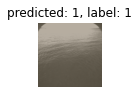

 75%|███████▌  | 9/12 [01:47<00:35, 11.81s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


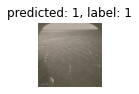

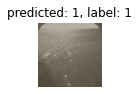

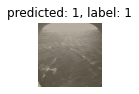

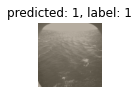

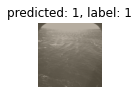

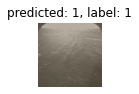

 83%|████████▎ | 10/12 [02:00<00:24, 12.07s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


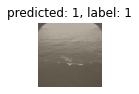

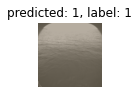

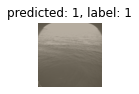

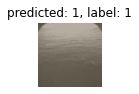

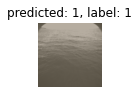

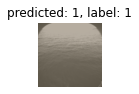

 92%|█████████▏| 11/12 [02:13<00:12, 12.26s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


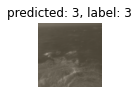

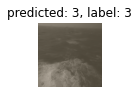

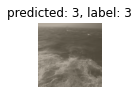

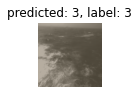

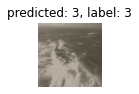

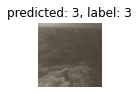

100%|██████████| 12/12 [02:25<00:00, 12.12s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_weighted_loss_tpn')

              precision    recall  f1-score   support

           1    0.97953   1.00000   0.98966      5455
           2    1.00000   0.96561   0.98250      3896
           3    0.97826   1.00000   0.98901       900

    accuracy                        0.98693     10251
   macro avg    0.98593   0.98854   0.98706     10251
weighted avg    0.98720   0.98693   0.98688     10251



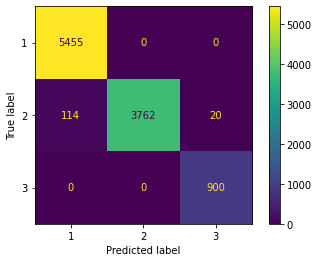

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cpu


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Model loaded from vgg16_splitted_untrained_v2_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1778/1799
Acurácia: 0.9883268482490273
----------------------


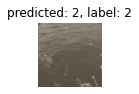

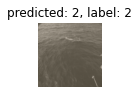

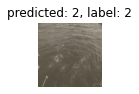

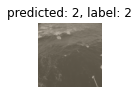

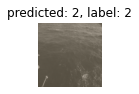

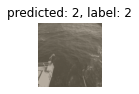

  8%|▊         | 1/12 [17:10<3:08:58, 1030.73s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:880/899
Acurácia: 0.978865406006674
----------------------


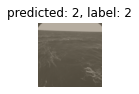

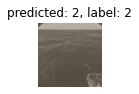

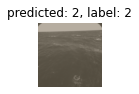

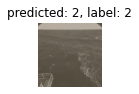

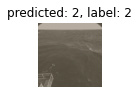

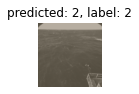

 17%|█▋        | 2/12 [25:48<2:01:28, 728.82s/it] 

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:895/898
Acurácia: 0.9966592427616926
----------------------


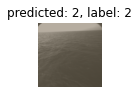

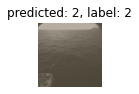

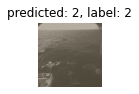

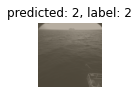

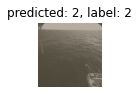

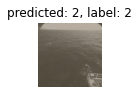

 25%|██▌       | 3/12 [34:25<1:34:49, 632.12s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:67/300
Acurácia: 0.22333333333333333
----------------------


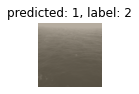

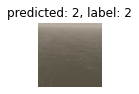

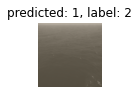

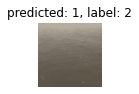

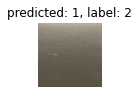

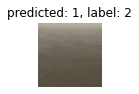

 33%|███▎      | 4/12 [37:22<1:00:18, 452.34s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:357/361
Acurácia: 0.9889196675900277
----------------------


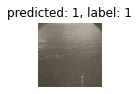

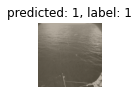

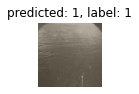

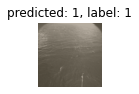

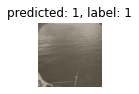

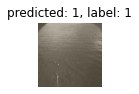

 42%|████▏     | 5/12 [40:56<42:44, 366.40s/it]  

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:596/599
Acurácia: 0.994991652754591
----------------------


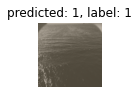

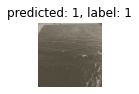

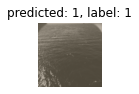

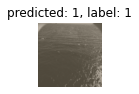

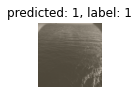

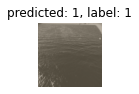

 50%|█████     | 6/12 [46:40<35:53, 358.98s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


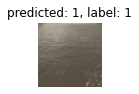

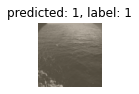

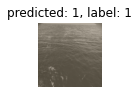

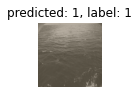

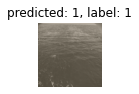

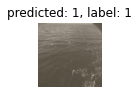

 58%|█████▊    | 7/12 [55:25<34:26, 413.35s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:861/899
Acurácia: 0.9577308120133482
----------------------


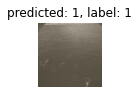

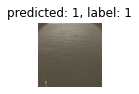

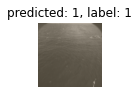

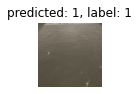

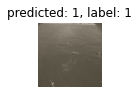

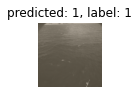

 67%|██████▋   | 8/12 [1:04:12<29:58, 449.55s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


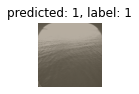

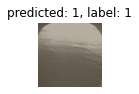

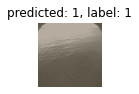

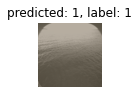

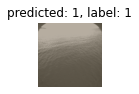

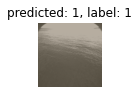

 75%|███████▌  | 9/12 [1:12:59<23:40, 473.66s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


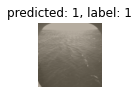

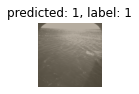

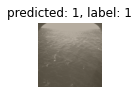

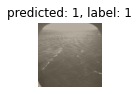

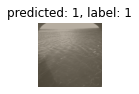

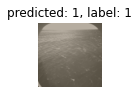

 83%|████████▎ | 10/12 [1:21:46<16:20, 490.16s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


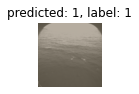

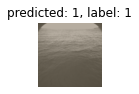

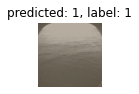

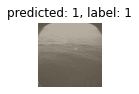

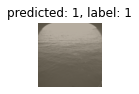

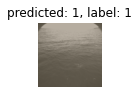

 92%|█████████▏| 11/12 [1:30:31<08:20, 500.61s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


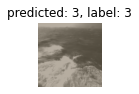

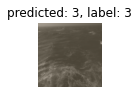

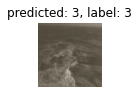

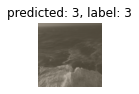

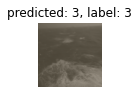

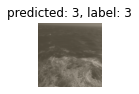

100%|██████████| 12/12 [1:39:17<00:00, 496.49s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_untrained_v2_tpn')

              precision    recall  f1-score   support

           1    0.95178   0.99138   0.97118      5455
           2    0.98745   0.92916   0.95742      3896
           3    0.99668   1.00000   0.99834       900

    accuracy                        0.96849     10251
   macro avg    0.97864   0.97351   0.97564     10251
weighted avg    0.96928   0.96849   0.96833     10251



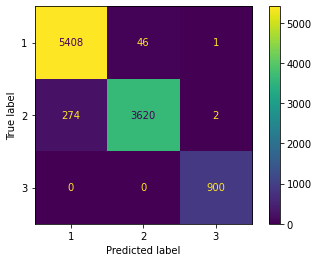

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34

Device: cuda:0
Model loaded from resnet34_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1762/1799
Acurácia: 0.9794330183435241
----------------------


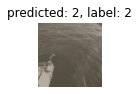

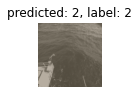

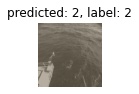

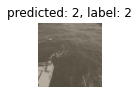

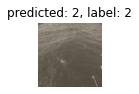

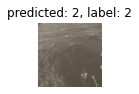

  8%|▊         | 1/12 [00:14<02:38, 14.45s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


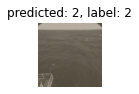

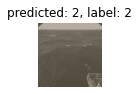

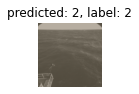

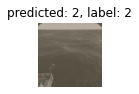

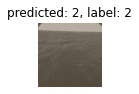

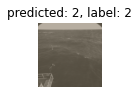

 17%|█▋        | 2/12 [00:22<01:45, 10.53s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:768/898
Acurácia: 0.8552338530066815
----------------------


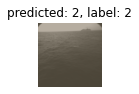

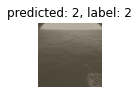

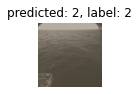

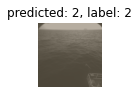

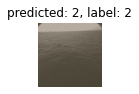

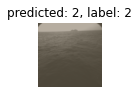

 25%|██▌       | 3/12 [00:30<01:25,  9.51s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:116/300
Acurácia: 0.38666666666666666
----------------------


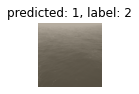

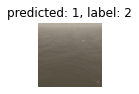

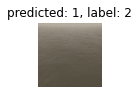

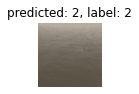

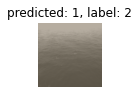

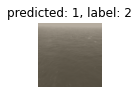

 33%|███▎      | 4/12 [00:34<00:57,  7.18s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:356/361
Acurácia: 0.9861495844875346
----------------------


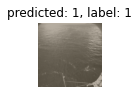

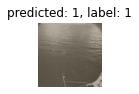

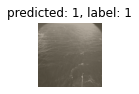

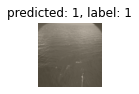

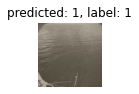

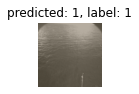

 42%|████▏     | 5/12 [00:38<00:42,  6.00s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:593/599
Acurácia: 0.989983305509182
----------------------


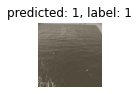

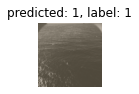

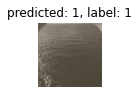

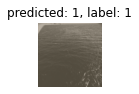

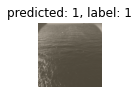

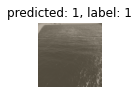

 50%|█████     | 6/12 [00:43<00:35,  5.88s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:791/899
Acurácia: 0.8798665183537263
----------------------


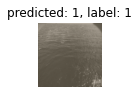

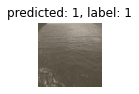

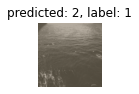

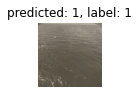

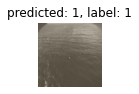

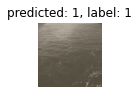

 58%|█████▊    | 7/12 [00:51<00:33,  6.64s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:885/899
Acurácia: 0.9844271412680756
----------------------


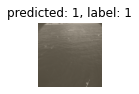

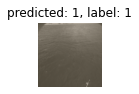

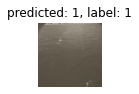

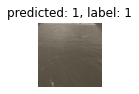

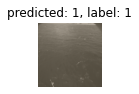

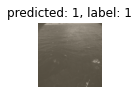

 67%|██████▋   | 8/12 [01:00<00:29,  7.28s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


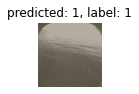

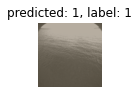

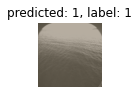

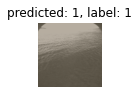

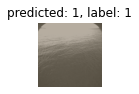

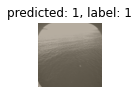

 75%|███████▌  | 9/12 [01:08<00:22,  7.59s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:866/899
Acurácia: 0.9632925472747497
----------------------


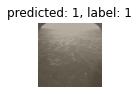

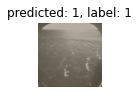

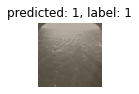

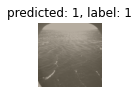

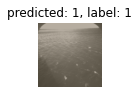

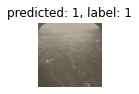

 83%|████████▎ | 10/12 [01:16<00:15,  7.72s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:896/899
Acurácia: 0.996662958843159
----------------------


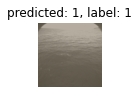

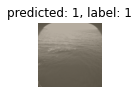

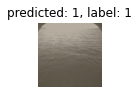

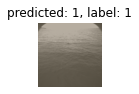

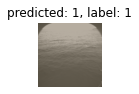

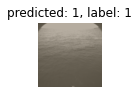

 92%|█████████▏| 11/12 [01:24<00:07,  7.83s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:897/900
Acurácia: 0.9966666666666667
----------------------


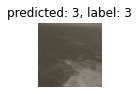

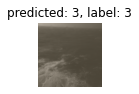

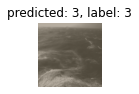

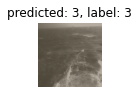

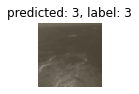

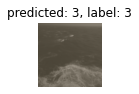

100%|██████████| 12/12 [01:33<00:00,  7.82s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_tpn')

              precision    recall  f1-score   support

           1    0.93790   0.96902   0.95321      5455
           2    0.96199   0.90939   0.93495      3896
           3    0.96245   0.99667   0.97926       900

    accuracy                        0.94879     10251
   macro avg    0.95411   0.95836   0.95580     10251
weighted avg    0.94921   0.94879   0.94856     10251



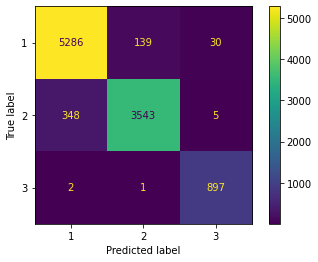

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1271/1799
Acurácia: 0.7065036131183992
----------------------


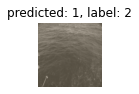

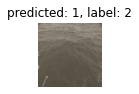

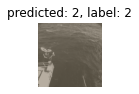

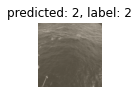

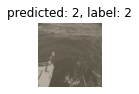

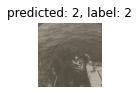

  8%|▊         | 1/12 [00:14<02:37, 14.31s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:832/899
Acurácia: 0.9254727474972191
----------------------


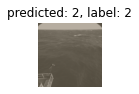

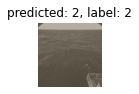

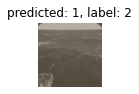

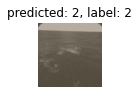

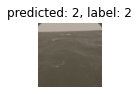

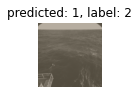

 17%|█▋        | 2/12 [00:22<01:45, 10.52s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:816/898
Acurácia: 0.9086859688195991
----------------------


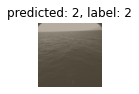

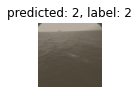

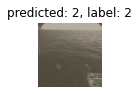

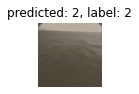

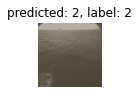

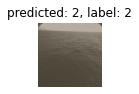

 25%|██▌       | 3/12 [00:30<01:26,  9.56s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:89/300
Acurácia: 0.2966666666666667
----------------------


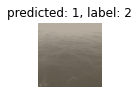

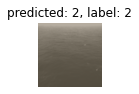

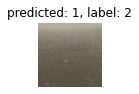

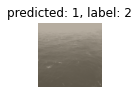

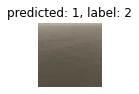

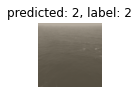

 33%|███▎      | 4/12 [00:34<00:57,  7.22s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:348/361
Acurácia: 0.96398891966759
----------------------


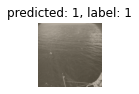

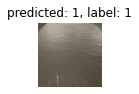

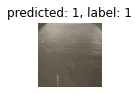

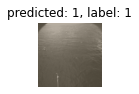

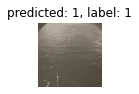

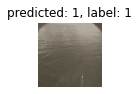

 42%|████▏     | 5/12 [00:38<00:42,  6.06s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:53/599
Acurácia: 0.08848080133555926
----------------------


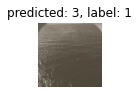

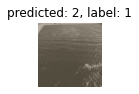

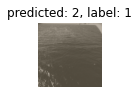

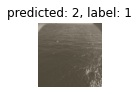

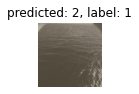

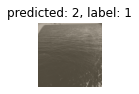

 50%|█████     | 6/12 [00:43<00:35,  5.85s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:793/899
Acurácia: 0.882091212458287
----------------------


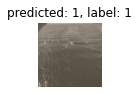

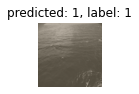

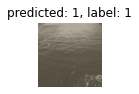

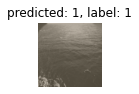

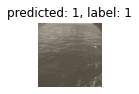

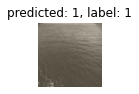

 58%|█████▊    | 7/12 [00:52<00:33,  6.70s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:214/899
Acurácia: 0.23804226918798665
----------------------


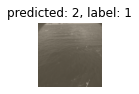

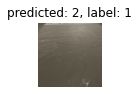

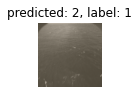

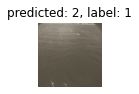

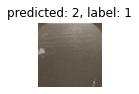

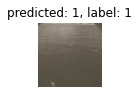

 67%|██████▋   | 8/12 [01:00<00:28,  7.08s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


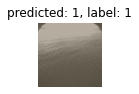

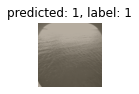

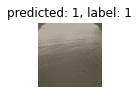

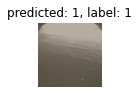

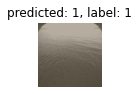

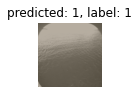

 75%|███████▌  | 9/12 [01:07<00:22,  7.34s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


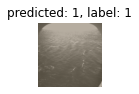

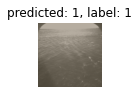

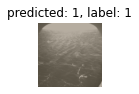

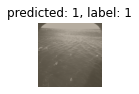

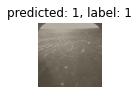

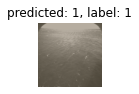

 83%|████████▎ | 10/12 [01:15<00:14,  7.49s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


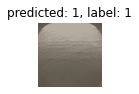

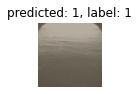

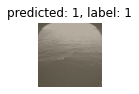

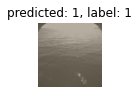

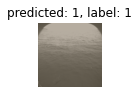

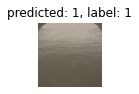

 92%|█████████▏| 11/12 [01:23<00:07,  7.59s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:483/900
Acurácia: 0.5366666666666666
----------------------


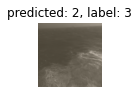

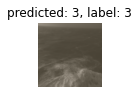

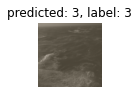

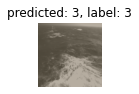

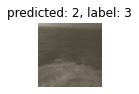

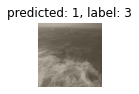

100%|██████████| 12/12 [01:31<00:00,  7.62s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_untrained_tpn')

              precision    recall  f1-score   support

           1    0.79308   0.75252   0.77227      5455
           2    0.67293   0.77207   0.71910      3896
           3    0.79835   0.53667   0.64186       900

    accuracy                        0.74100     10251
   macro avg    0.75479   0.68709   0.71108     10251
weighted avg    0.74788   0.74100   0.74061     10251



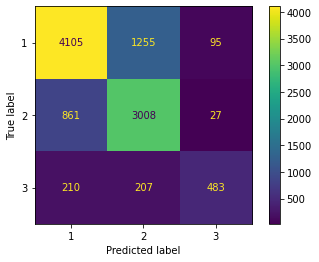

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1780/1799
Acurácia: 0.9894385769872152
----------------------


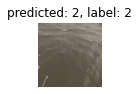

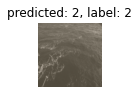

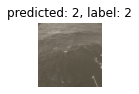

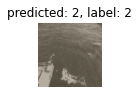

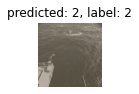

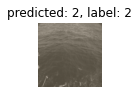

  8%|▊         | 1/12 [00:14<02:37, 14.34s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:894/899
Acurácia: 0.9944382647385984
----------------------


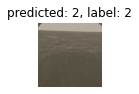

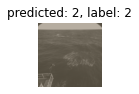

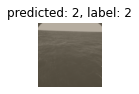

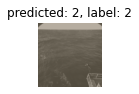

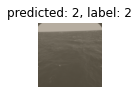

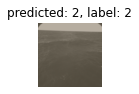

 17%|█▋        | 2/12 [00:22<01:45, 10.57s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:762/898
Acurácia: 0.8485523385300668
----------------------


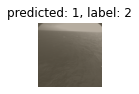

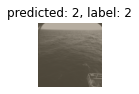

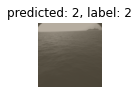

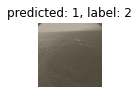

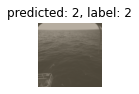

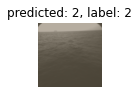

 25%|██▌       | 3/12 [00:30<01:25,  9.52s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:121/300
Acurácia: 0.4033333333333333
----------------------


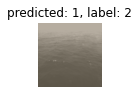

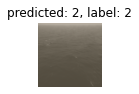

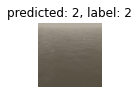

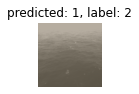

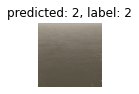

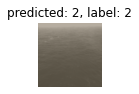

 33%|███▎      | 4/12 [00:35<01:00,  7.55s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:359/361
Acurácia: 0.9944598337950139
----------------------


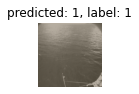

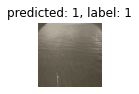

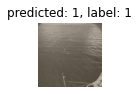

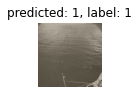

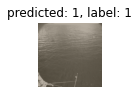

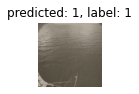

 42%|████▏     | 5/12 [00:39<00:43,  6.27s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:589/599
Acurácia: 0.9833055091819699
----------------------


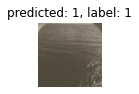

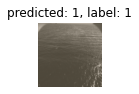

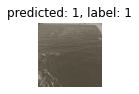

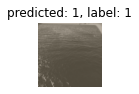

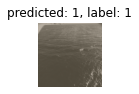

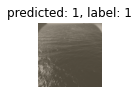

 50%|█████     | 6/12 [00:44<00:35,  5.98s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:784/899
Acurácia: 0.8720800889877642
----------------------


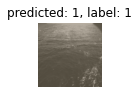

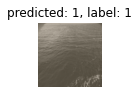

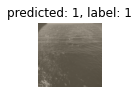

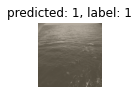

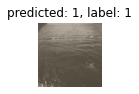

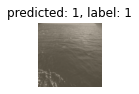

 58%|█████▊    | 7/12 [00:52<00:33,  6.78s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:875/899
Acurácia: 0.9733036707452726
----------------------


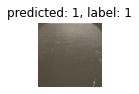

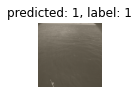

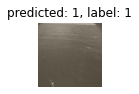

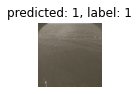

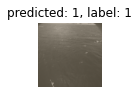

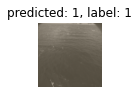

 67%|██████▋   | 8/12 [01:01<00:29,  7.26s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


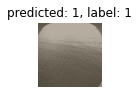

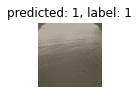

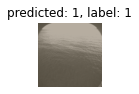

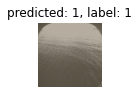

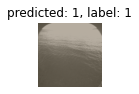

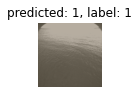

 75%|███████▌  | 9/12 [01:09<00:22,  7.49s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:865/899
Acurácia: 0.9621802002224694
----------------------


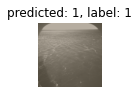

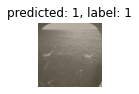

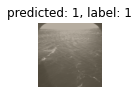

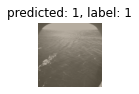

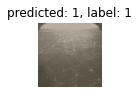

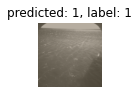

 83%|████████▎ | 10/12 [01:16<00:15,  7.58s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:892/899
Acurácia: 0.9922135706340378
----------------------


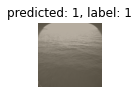

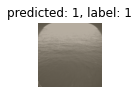

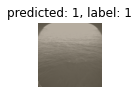

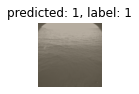

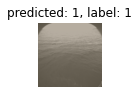

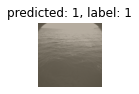

 92%|█████████▏| 11/12 [01:24<00:07,  7.67s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:899/900
Acurácia: 0.9988888888888889
----------------------


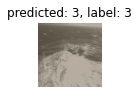

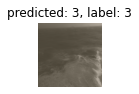

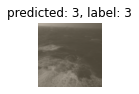

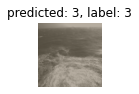

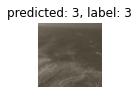

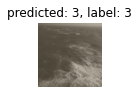

100%|██████████| 12/12 [01:32<00:00,  7.72s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_oversample_tpn')

              precision    recall  f1-score   support

           1    0.94016   0.96480   0.95232      5455
           2    0.95902   0.91299   0.93544      3896
           3    0.95233   0.99889   0.97505       900

    accuracy                        0.94810     10251
   macro avg    0.95050   0.95889   0.95427     10251
weighted avg    0.94839   0.94810   0.94790     10251



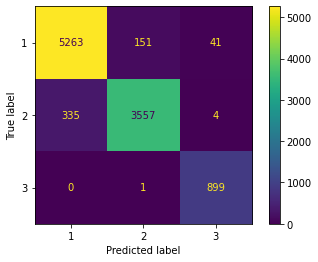

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1787/1799
Acurácia: 0.9933296275708727
----------------------


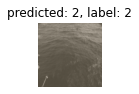

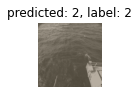

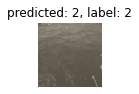

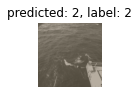

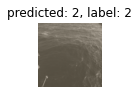

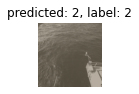

  8%|▊         | 1/12 [00:14<02:38, 14.43s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


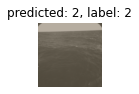

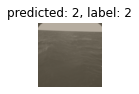

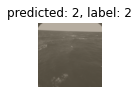

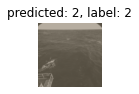

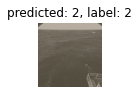

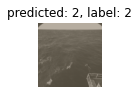

 17%|█▋        | 2/12 [00:22<01:46, 10.61s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:779/898
Acurácia: 0.8674832962138085
----------------------


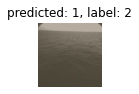

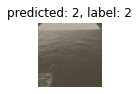

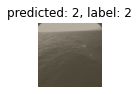

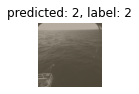

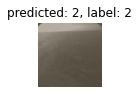

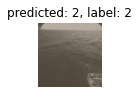

 25%|██▌       | 3/12 [00:30<01:26,  9.62s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:222/300
Acurácia: 0.74
----------------------


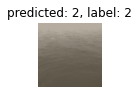

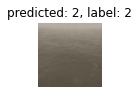

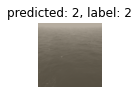

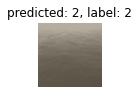

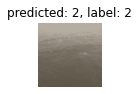

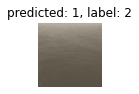

 33%|███▎      | 4/12 [00:34<00:58,  7.27s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:349/361
Acurácia: 0.9667590027700831
----------------------


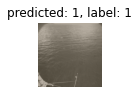

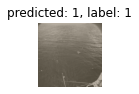

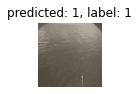

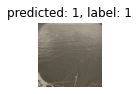

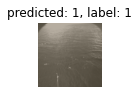

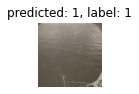

 42%|████▏     | 5/12 [00:38<00:42,  6.10s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:578/599
Acurácia: 0.9649415692821369
----------------------


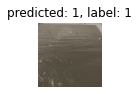

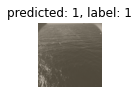

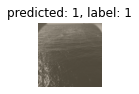

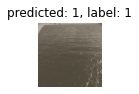

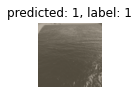

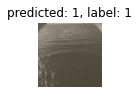

 50%|█████     | 6/12 [00:44<00:35,  5.91s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:707/899
Acurácia: 0.7864293659621802
----------------------


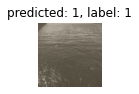

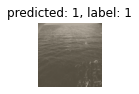

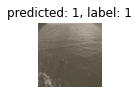

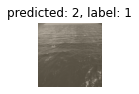

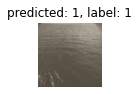

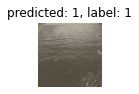

 58%|█████▊    | 7/12 [00:52<00:33,  6.72s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:863/899
Acurácia: 0.9599555061179088
----------------------


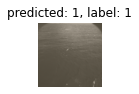

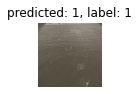

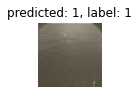

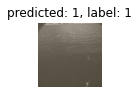

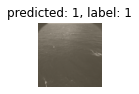

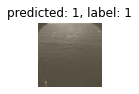

 67%|██████▋   | 8/12 [01:00<00:29,  7.26s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


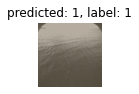

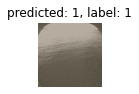

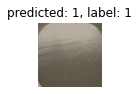

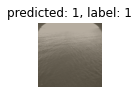

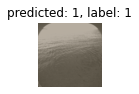

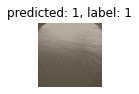

 75%|███████▌  | 9/12 [01:09<00:23,  7.71s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:845/899
Acurácia: 0.9399332591768632
----------------------


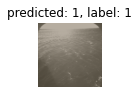

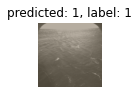

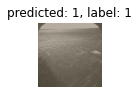

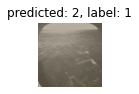

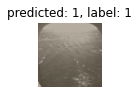

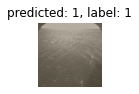

 83%|████████▎ | 10/12 [01:17<00:15,  7.75s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:886/899
Acurácia: 0.985539488320356
----------------------


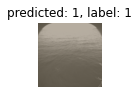

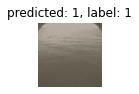

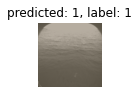

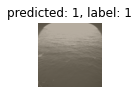

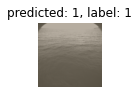

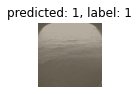

 92%|█████████▏| 11/12 [01:25<00:07,  7.75s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:899/900
Acurácia: 0.9988888888888889
----------------------


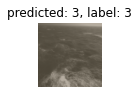

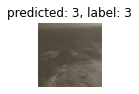

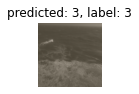

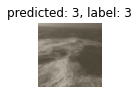

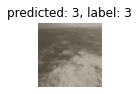

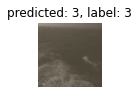

100%|██████████| 12/12 [01:32<00:00,  7.75s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_loss_tpn')

              precision    recall  f1-score   support

           1    0.96137   0.93987   0.95050      5455
           2    0.92313   0.94636   0.93460      3896
           3    0.97294   0.99889   0.98575       900

    accuracy                        0.94752     10251
   macro avg    0.95248   0.96171   0.95695     10251
weighted avg    0.94786   0.94752   0.94755     10251



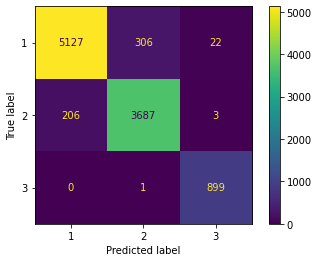

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet152

Device: cuda:0
Model loaded from resnet152_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1791/1799
Acurácia: 0.9955530850472485
----------------------


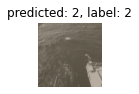

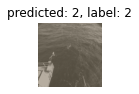

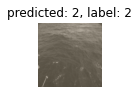

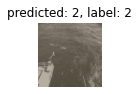

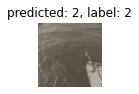

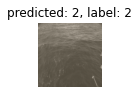

  8%|▊         | 1/12 [00:26<04:46, 26.06s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:896/899
Acurácia: 0.996662958843159
----------------------


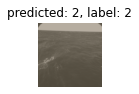

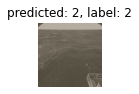

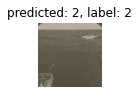

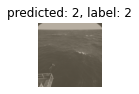

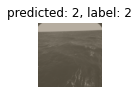

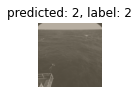

 17%|█▋        | 2/12 [00:38<03:02, 18.24s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:876/898
Acurácia: 0.9755011135857461
----------------------


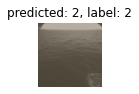

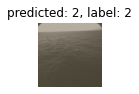

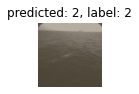

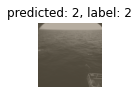

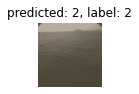

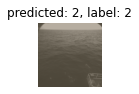

 25%|██▌       | 3/12 [00:52<02:24, 16.07s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:151/300
Acurácia: 0.5033333333333333
----------------------


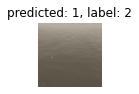

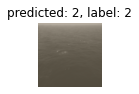

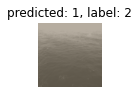

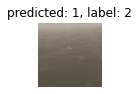

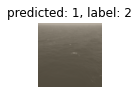

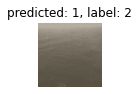

 33%|███▎      | 4/12 [00:57<01:35, 11.89s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


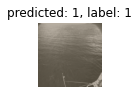

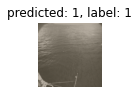

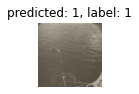

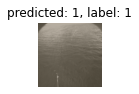

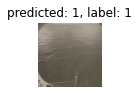

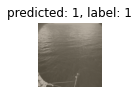

 42%|████▏     | 5/12 [01:04<01:09,  9.94s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:597/599
Acurácia: 0.996661101836394
----------------------


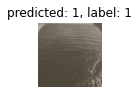

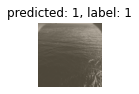

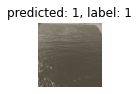

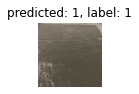

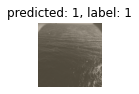

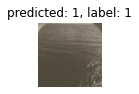

 50%|█████     | 6/12 [01:13<00:58,  9.69s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:837/899
Acurácia: 0.9310344827586207
----------------------


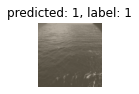

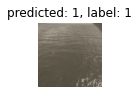

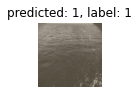

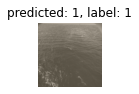

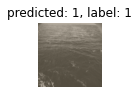

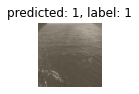

 58%|█████▊    | 7/12 [01:27<00:55, 11.01s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:849/899
Acurácia: 0.9443826473859844
----------------------


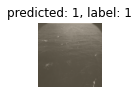

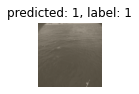

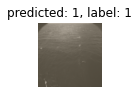

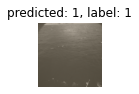

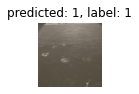

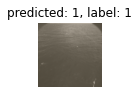

 67%|██████▋   | 8/12 [01:41<00:48, 12.14s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:871/899
Acurácia: 0.9688542825361512
----------------------


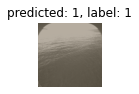

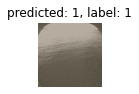

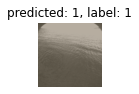

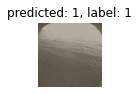

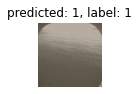

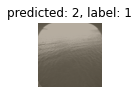

 75%|███████▌  | 9/12 [01:55<00:38, 12.70s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


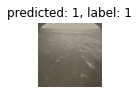

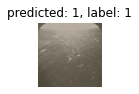

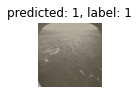

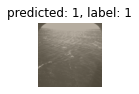

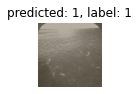

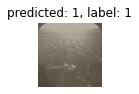

 83%|████████▎ | 10/12 [02:09<00:25, 12.92s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


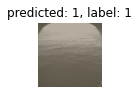

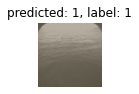

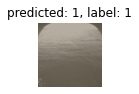

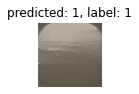

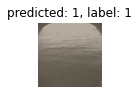

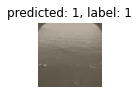

 92%|█████████▏| 11/12 [02:22<00:13, 13.04s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:899/900
Acurácia: 0.9988888888888889
----------------------


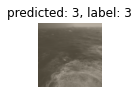

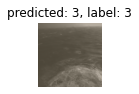

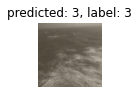

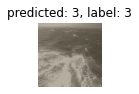

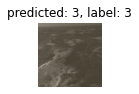

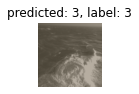

100%|██████████| 12/12 [02:36<00:00, 13.00s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_tpn')

              precision    recall  f1-score   support

           1    0.96688   0.97397   0.97041      5455
           2    0.96392   0.95329   0.95858      3896
           3    0.99557   0.99889   0.99723       900

    accuracy                        0.96830     10251
   macro avg    0.97546   0.97538   0.97540     10251
weighted avg    0.96827   0.96830   0.96827     10251



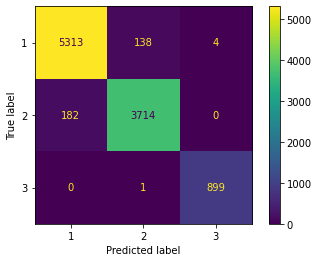

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1763/1799
Acurácia: 0.9799888827126181
----------------------


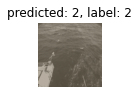

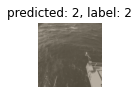

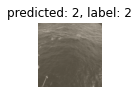

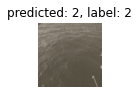

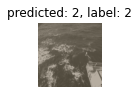

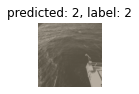

  8%|▊         | 1/12 [00:25<04:45, 25.98s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:864/899
Acurácia: 0.9610678531701891
----------------------


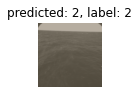

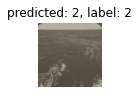

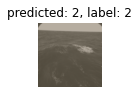

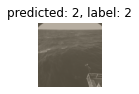

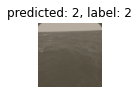

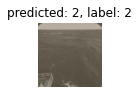

 17%|█▋        | 2/12 [00:39<03:04, 18.45s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:896/898
Acurácia: 0.9977728285077951
----------------------


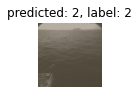

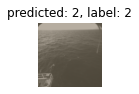

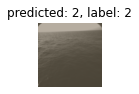

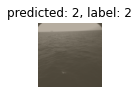

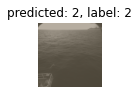

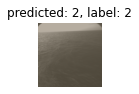

 25%|██▌       | 3/12 [00:53<02:27, 16.43s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:265/300
Acurácia: 0.8833333333333333
----------------------


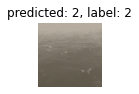

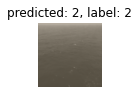

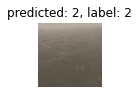

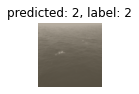

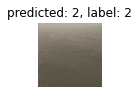

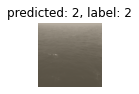

 33%|███▎      | 4/12 [00:58<01:37, 12.14s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:16/361
Acurácia: 0.0443213296398892
----------------------


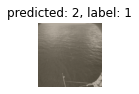

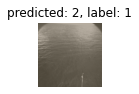

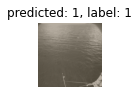

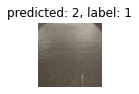

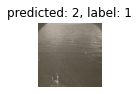

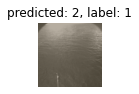

 42%|████▏     | 5/12 [01:05<01:11, 10.15s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:3/599
Acurácia: 0.005008347245409015
----------------------


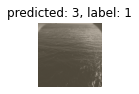

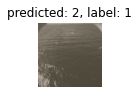

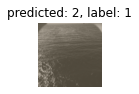

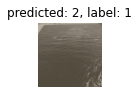

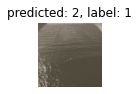

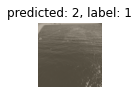

 50%|█████     | 6/12 [01:14<00:58,  9.81s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:96/899
Acurácia: 0.1067853170189099
----------------------


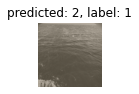

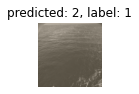

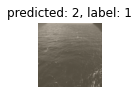

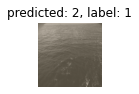

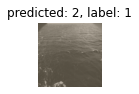

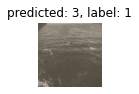

 58%|█████▊    | 7/12 [01:28<00:55, 11.16s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:2/899
Acurácia: 0.002224694104560623
----------------------


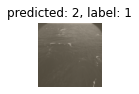

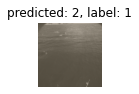

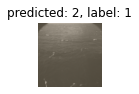

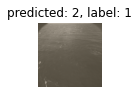

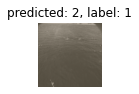

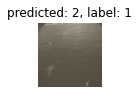

 67%|██████▋   | 8/12 [01:42<00:48, 12.06s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:639/899
Acurácia: 0.710789766407119
----------------------


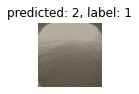

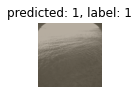

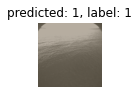

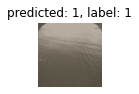

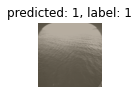

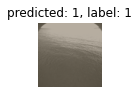

 75%|███████▌  | 9/12 [01:56<00:37, 12.60s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:459/899
Acurácia: 0.5105672969966629
----------------------


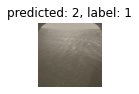

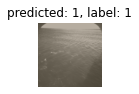

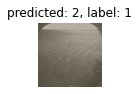

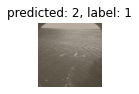

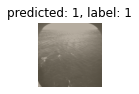

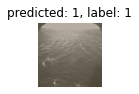

 83%|████████▎ | 10/12 [02:09<00:25, 12.92s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:722/899
Acurácia: 0.8031145717463849
----------------------


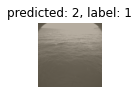

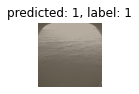

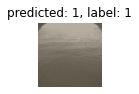

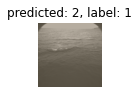

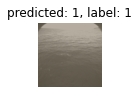

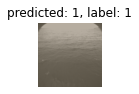

 92%|█████████▏| 11/12 [02:23<00:13, 13.09s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:181/900
Acurácia: 0.2011111111111111
----------------------


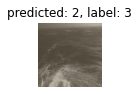

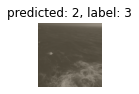

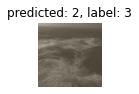

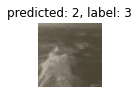

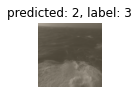

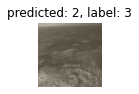

100%|██████████| 12/12 [02:36<00:00, 13.07s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_untrained_tpn')

              precision    recall  f1-score   support

           1    0.94858   0.35509   0.51674      5455
           2    0.48552   0.97228   0.64763      3896
           3    0.44472   0.20111   0.27697       900

    accuracy                        0.57614     10251
   macro avg    0.62627   0.50949   0.48045     10251
weighted avg    0.72835   0.57614   0.54544     10251



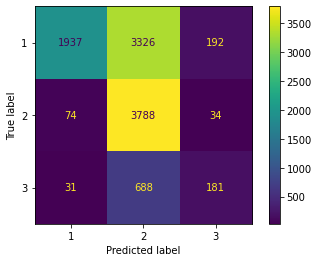

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1797/1799
Acurácia: 0.9988882712618121
----------------------


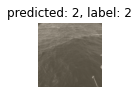

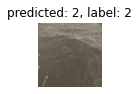

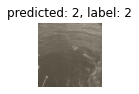

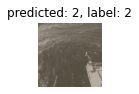

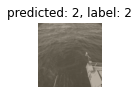

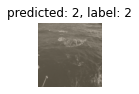

  8%|▊         | 1/12 [00:25<04:43, 25.77s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


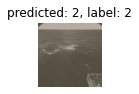

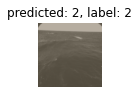

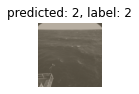

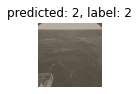

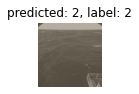

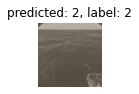

 17%|█▋        | 2/12 [00:39<03:05, 18.60s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:898/898
Acurácia: 1.0
----------------------


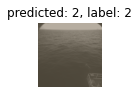

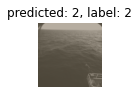

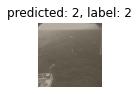

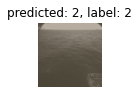

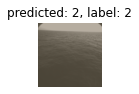

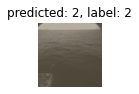

 25%|██▌       | 3/12 [00:53<02:27, 16.41s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:300/300
Acurácia: 1.0
----------------------


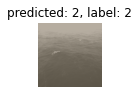

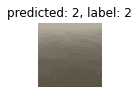

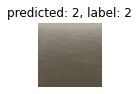

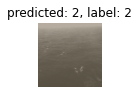

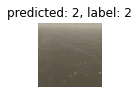

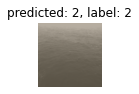

 33%|███▎      | 4/12 [00:58<01:36, 12.09s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:2/361
Acurácia: 0.00554016620498615
----------------------


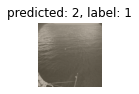

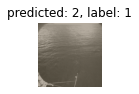

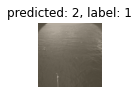

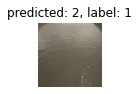

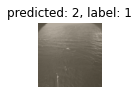

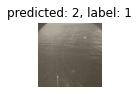

 42%|████▏     | 5/12 [01:04<01:10, 10.00s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:0/599
Acurácia: 0.0
----------------------


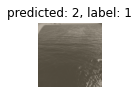

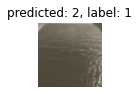

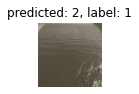

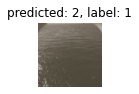

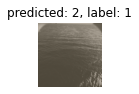

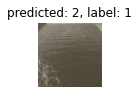

 50%|█████     | 6/12 [01:14<00:58,  9.72s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:7/899
Acurácia: 0.00778642936596218
----------------------


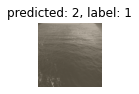

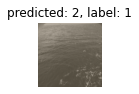

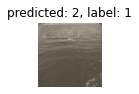

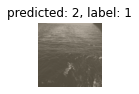

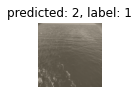

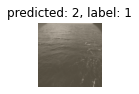

 58%|█████▊    | 7/12 [01:27<00:55, 11.08s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:0/899
Acurácia: 0.0
----------------------


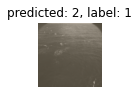

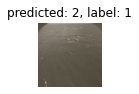

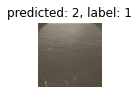

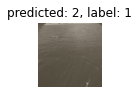

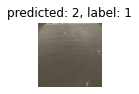

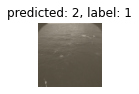

 67%|██████▋   | 8/12 [01:41<00:48, 12.01s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:13/899
Acurácia: 0.014460511679644048
----------------------


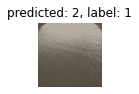

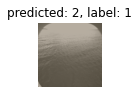

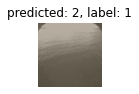

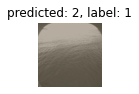

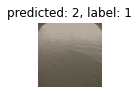

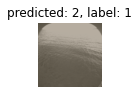

 75%|███████▌  | 9/12 [01:55<00:37, 12.56s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:43/899
Acurácia: 0.047830923248053395
----------------------


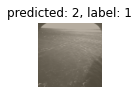

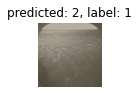

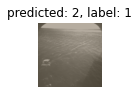

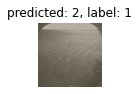

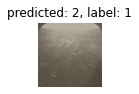

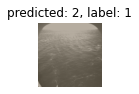

 83%|████████▎ | 10/12 [02:09<00:25, 12.91s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:13/899
Acurácia: 0.014460511679644048
----------------------


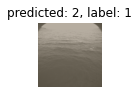

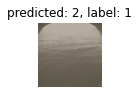

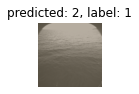

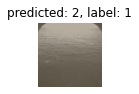

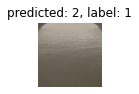

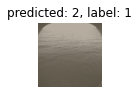

 92%|█████████▏| 11/12 [02:22<00:13, 13.08s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:0/900
Acurácia: 0.0
----------------------


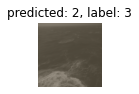

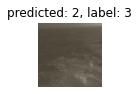

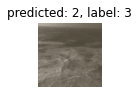

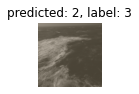

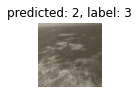

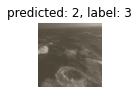

100%|██████████| 12/12 [02:36<00:00, 13.01s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_oversample_tpn')

              precision    recall  f1-score   support

           1    0.78788   0.01430   0.02809      5455
           2    0.38337   0.99897   0.55410      3896
           3    0.00000   0.00000   0.00000       900

    accuracy                        0.38728     10251
   macro avg    0.39042   0.33776   0.19406     10251
weighted avg    0.56497   0.38728   0.22554     10251



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


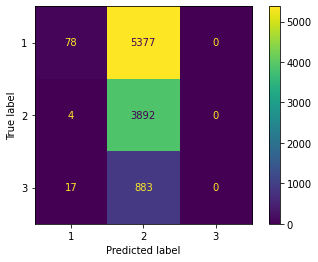

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1795/1799
Acurácia: 0.9977765425236242
----------------------


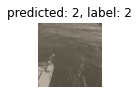

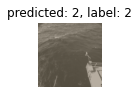

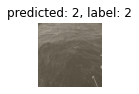

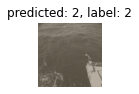

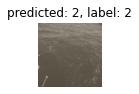

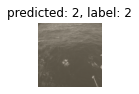

  8%|▊         | 1/12 [00:25<04:45, 26.00s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


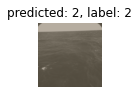

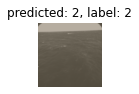

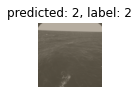

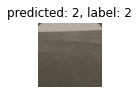

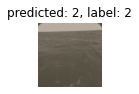

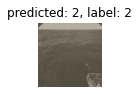

 17%|█▋        | 2/12 [00:38<03:02, 18.29s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:887/898
Acurácia: 0.987750556792873
----------------------


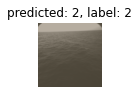

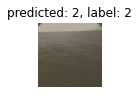

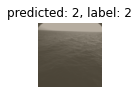

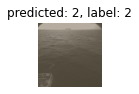

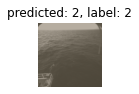

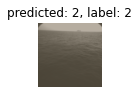

 25%|██▌       | 3/12 [00:52<02:25, 16.16s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:204/300
Acurácia: 0.68
----------------------


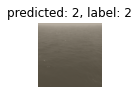

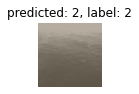

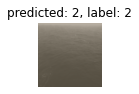

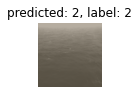

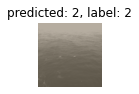

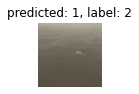

 33%|███▎      | 4/12 [00:58<01:35, 11.98s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:360/361
Acurácia: 0.997229916897507
----------------------


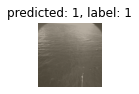

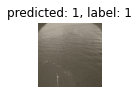

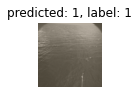

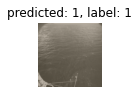

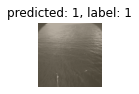

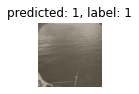

 42%|████▏     | 5/12 [01:04<01:09,  9.92s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:586/599
Acurácia: 0.9782971619365609
----------------------


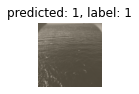

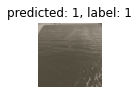

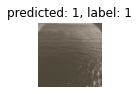

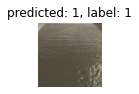

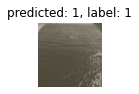

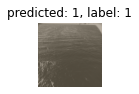

 50%|█████     | 6/12 [01:13<00:58,  9.72s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:677/899
Acurácia: 0.7530589543937709
----------------------


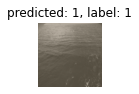

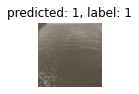

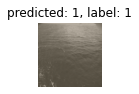

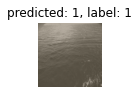

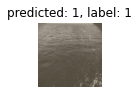

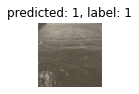

 58%|█████▊    | 7/12 [01:27<00:54, 10.95s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:696/899
Acurácia: 0.7741935483870968
----------------------


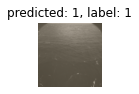

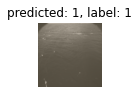

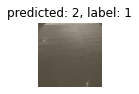

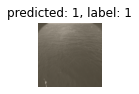

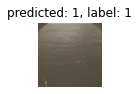

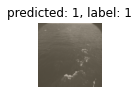

 67%|██████▋   | 8/12 [01:40<00:47, 11.75s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:884/899
Acurácia: 0.9833147942157954
----------------------


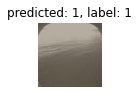

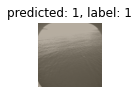

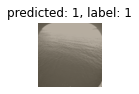

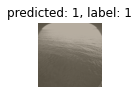

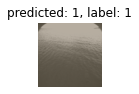

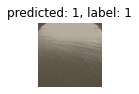

 75%|███████▌  | 9/12 [01:54<00:36, 12.29s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


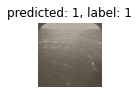

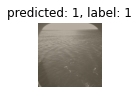

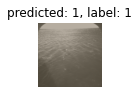

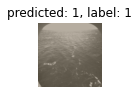

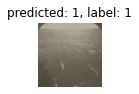

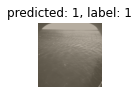

 83%|████████▎ | 10/12 [02:07<00:25, 12.72s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:895/899
Acurácia: 0.9955506117908788
----------------------


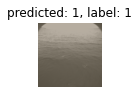

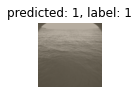

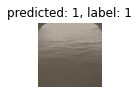

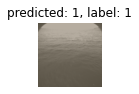

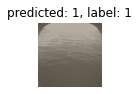

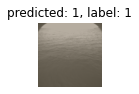

 92%|█████████▏| 11/12 [02:21<00:12, 12.88s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


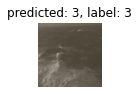

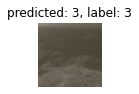

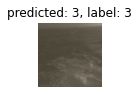

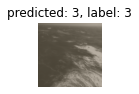

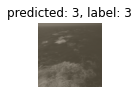

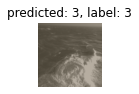

100%|██████████| 12/12 [02:34<00:00, 12.85s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_loss_tpn')

              precision    recall  f1-score   support

           1    0.97846   0.91604   0.94622      5455
           2    0.89948   0.97151   0.93411      3896
           3    0.96154   1.00000   0.98039       900

    accuracy                        0.94449     10251
   macro avg    0.94649   0.96252   0.95357     10251
weighted avg    0.94696   0.94449   0.94462     10251



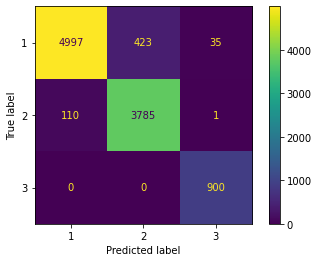

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1787/1799
Acurácia: 0.9933296275708727
----------------------


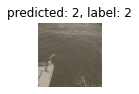

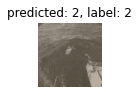

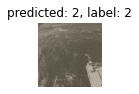

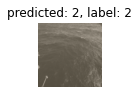

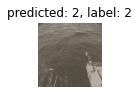

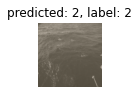

  8%|▊         | 1/12 [00:25<04:45, 25.92s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


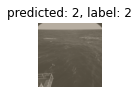

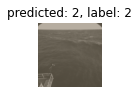

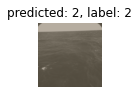

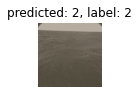

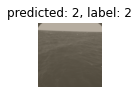

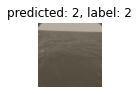

 17%|█▋        | 2/12 [00:38<03:00, 18.09s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:872/898
Acurácia: 0.9710467706013363
----------------------


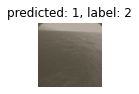

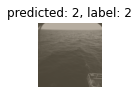

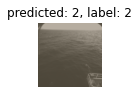

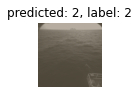

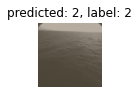

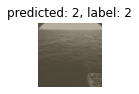

 25%|██▌       | 3/12 [00:51<02:22, 15.87s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:166/300
Acurácia: 0.5533333333333333
----------------------


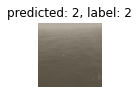

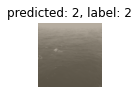

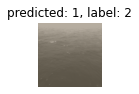

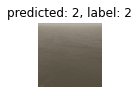

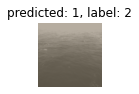

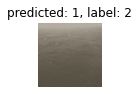

 33%|███▎      | 4/12 [00:57<01:34, 11.83s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


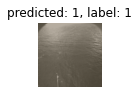

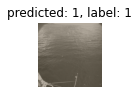

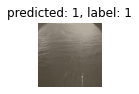

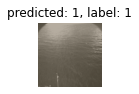

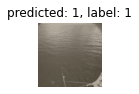

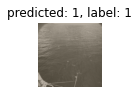

 42%|████▏     | 5/12 [01:03<01:08,  9.83s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:597/599
Acurácia: 0.996661101836394
----------------------


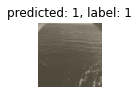

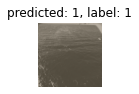

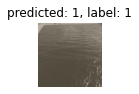

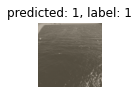

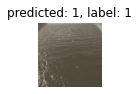

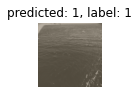

 50%|█████     | 6/12 [01:12<00:57,  9.58s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:846/899
Acurácia: 0.9410456062291435
----------------------


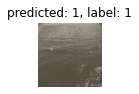

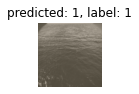

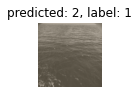

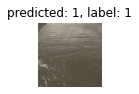

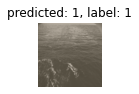

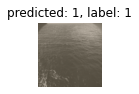

 58%|█████▊    | 7/12 [01:26<00:54, 10.89s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:865/899
Acurácia: 0.9621802002224694
----------------------


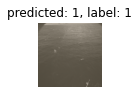

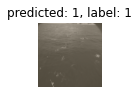

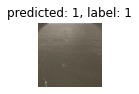

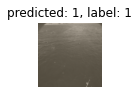

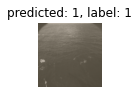

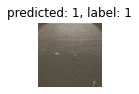

 67%|██████▋   | 8/12 [01:40<00:47, 11.85s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:885/899
Acurácia: 0.9844271412680756
----------------------


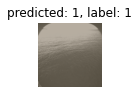

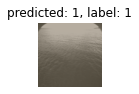

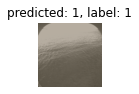

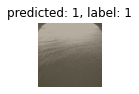

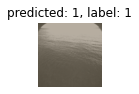

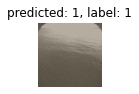

 75%|███████▌  | 9/12 [01:54<00:37, 12.44s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


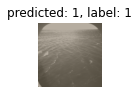

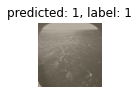

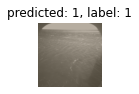

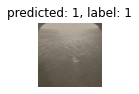

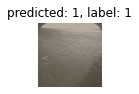

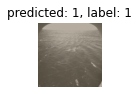

 83%|████████▎ | 10/12 [02:07<00:25, 12.84s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:894/899
Acurácia: 0.9944382647385984
----------------------


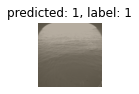

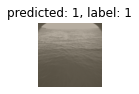

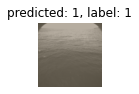

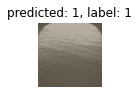

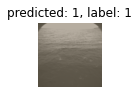

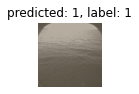

 92%|█████████▏| 11/12 [02:21<00:13, 13.14s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


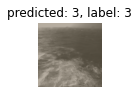

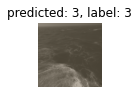

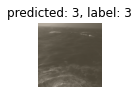

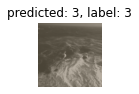

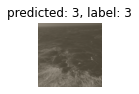

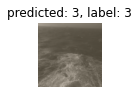

100%|██████████| 12/12 [02:35<00:00, 12.94s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_oversample_v2_tpn')

              precision    recall  f1-score   support

           1    0.96848   0.98020   0.97431      5455
           2    0.97155   0.95534   0.96338      3896
           3    0.99889   0.99778   0.99833       900

    accuracy                        0.97230     10251
   macro avg    0.97964   0.97777   0.97867     10251
weighted avg    0.97232   0.97230   0.97226     10251



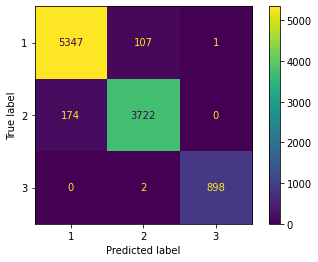

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34_VGG

Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1789/1799
Acurácia: 0.9944413563090606
----------------------


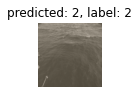

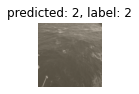

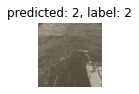

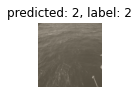

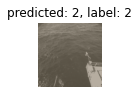

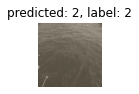

  8%|▊         | 1/12 [00:14<02:43, 14.87s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:889/899
Acurácia: 0.9888765294771968
----------------------


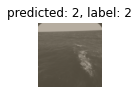

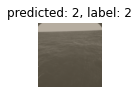

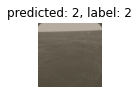

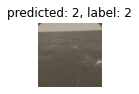

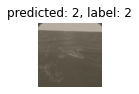

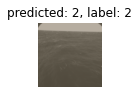

 17%|█▋        | 2/12 [00:22<01:47, 10.72s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:774/898
Acurácia: 0.8619153674832962
----------------------


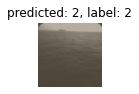

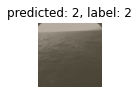

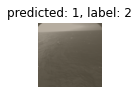

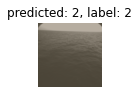

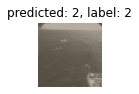

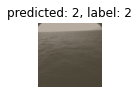

 25%|██▌       | 3/12 [00:31<01:27,  9.69s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:152/300
Acurácia: 0.5066666666666667
----------------------


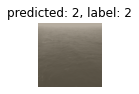

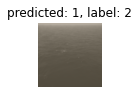

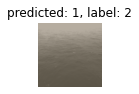

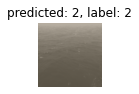

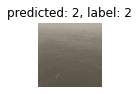

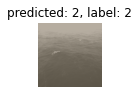

 33%|███▎      | 4/12 [00:34<00:58,  7.35s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:357/361
Acurácia: 0.9889196675900277
----------------------


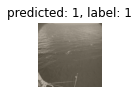

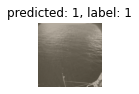

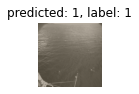

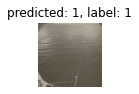

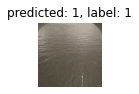

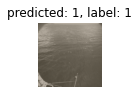

 42%|████▏     | 5/12 [00:39<00:43,  6.21s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:597/599
Acurácia: 0.996661101836394
----------------------


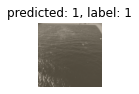

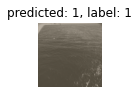

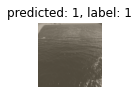

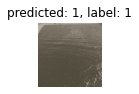

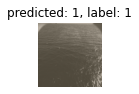

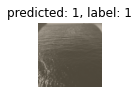

 50%|█████     | 6/12 [00:44<00:35,  5.97s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:795/899
Acurácia: 0.8843159065628476
----------------------


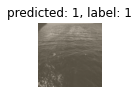

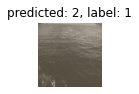

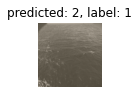

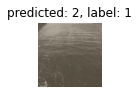

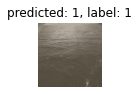

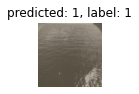

 58%|█████▊    | 7/12 [00:53<00:34,  6.80s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:883/899
Acurácia: 0.982202447163515
----------------------


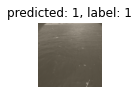

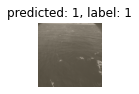

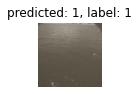

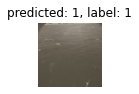

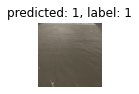

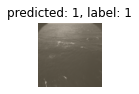

 67%|██████▋   | 8/12 [01:01<00:29,  7.33s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


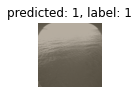

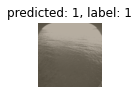

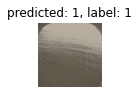

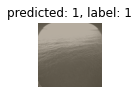

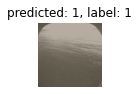

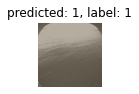

 75%|███████▌  | 9/12 [01:09<00:22,  7.63s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:881/899
Acurácia: 0.9799777530589544
----------------------


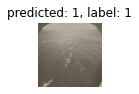

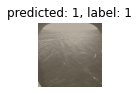

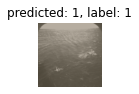

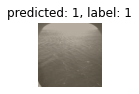

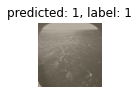

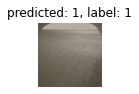

 83%|████████▎ | 10/12 [01:17<00:15,  7.71s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


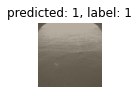

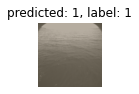

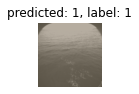

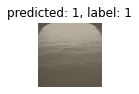

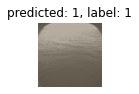

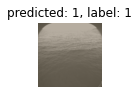

 92%|█████████▏| 11/12 [01:25<00:07,  7.83s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


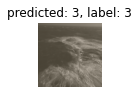

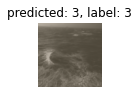

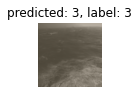

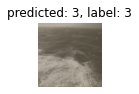

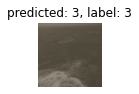

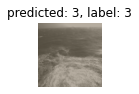

100%|██████████| 12/12 [01:33<00:00,  7.83s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_tpn')

              precision    recall  f1-score   support

           1    0.94906   0.97342   0.96109      5455
           2    0.96752   0.92505   0.94581      3896
           3    0.96455   0.99778   0.98088       900

    accuracy                        0.95717     10251
   macro avg    0.96038   0.96542   0.96259     10251
weighted avg    0.95744   0.95717   0.95702     10251



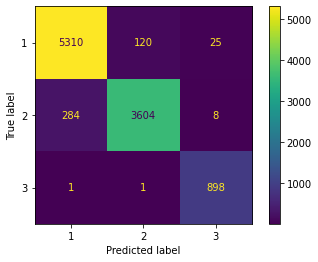

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1796/1799
Acurácia: 0.9983324068927182
----------------------


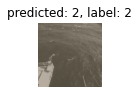

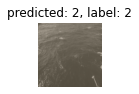

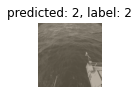

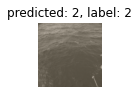

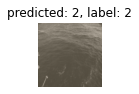

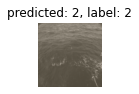

  8%|▊         | 1/12 [04:31<49:42, 271.18s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


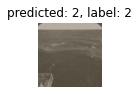

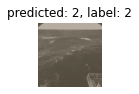

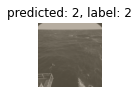

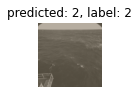

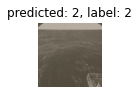

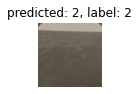

 17%|█▋        | 2/12 [06:43<31:36, 189.61s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:843/898
Acurácia: 0.9387527839643652
----------------------


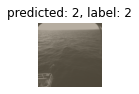

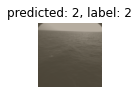

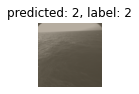

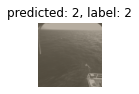

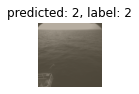

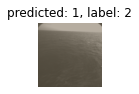

 25%|██▌       | 3/12 [08:57<24:35, 163.93s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:238/300
Acurácia: 0.7933333333333333
----------------------


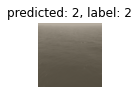

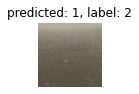

 33%|███▎      | 4/12 [09:43<15:41, 117.68s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:358/361
Acurácia: 0.9916897506925207
----------------------


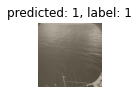

 42%|████▏     | 5/12 [10:38<11:03, 94.84s/it] 

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:587/599
Acurácia: 0.9799666110183639
----------------------


 50%|█████     | 6/12 [12:06<09:15, 92.55s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:762/899
Acurácia: 0.8476084538375973
----------------------


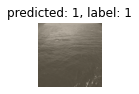

 58%|█████▊    | 7/12 [14:17<08:45, 105.07s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:861/899
Acurácia: 0.9577308120133482
----------------------


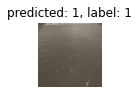

 67%|██████▋   | 8/12 [16:25<07:30, 112.64s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 75%|███████▌  | 9/12 [18:37<05:56, 118.68s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:844/899
Acurácia: 0.9388209121245829
----------------------


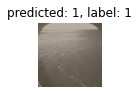

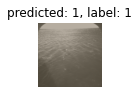

 83%|████████▎ | 10/12 [20:53<04:07, 123.79s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:885/899
Acurácia: 0.9844271412680756
----------------------


 92%|█████████▏| 11/12 [23:08<02:07, 127.34s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:899/900
Acurácia: 0.9988888888888889
----------------------


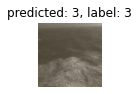

100%|██████████| 12/12 [25:28<00:00, 127.34s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_oversample_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.97724   0.95252   0.96472      5455
           2    0.94069   0.96894   0.95461      3896
           3    0.97611   0.99889   0.98737       900

    accuracy                        0.96283     10251
   macro avg    0.96468   0.97345   0.96890     10251
weighted avg    0.96325   0.96283   0.96287     10251



Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1773/1799
Acurácia: 0.9855475264035576
----------------------


  8%|▊         | 1/12 [04:36<50:36, 276.04s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:891/899
Acurácia: 0.9911012235817576
----------------------


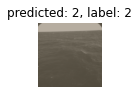

 17%|█▋        | 2/12 [06:45<31:40, 190.00s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:802/898
Acurácia: 0.8930957683741648
----------------------


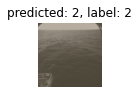

 25%|██▌       | 3/12 [08:54<24:18, 162.05s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:159/300
Acurácia: 0.53
----------------------


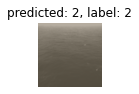

 33%|███▎      | 4/12 [09:39<15:27, 115.89s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:359/361
Acurácia: 0.9944598337950139
----------------------


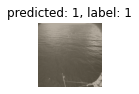

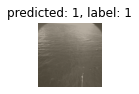

 42%|████▏     | 5/12 [10:33<10:54, 93.55s/it] 

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:598/599
Acurácia: 0.998330550918197
----------------------


 50%|█████     | 6/12 [12:07<09:21, 93.63s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:830/899
Acurácia: 0.9232480533926585
----------------------


 58%|█████▊    | 7/12 [14:27<09:03, 108.73s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:888/899
Acurácia: 0.9877641824249166
----------------------


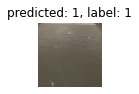

 67%|██████▋   | 8/12 [16:41<07:46, 116.69s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


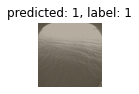

 75%|███████▌  | 9/12 [18:51<06:03, 121.05s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:877/899
Acurácia: 0.9755283648498332
----------------------


 83%|████████▎ | 10/12 [21:03<04:08, 124.29s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


 92%|█████████▏| 11/12 [23:14<02:06, 126.39s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


100%|██████████| 12/12 [25:22<00:00, 126.92s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_loss_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.95263   0.98057   0.96640      5455
           2    0.97683   0.93044   0.95307      3896
           3    0.97081   0.99778   0.98411       900

    accuracy                        0.96303     10251
   macro avg    0.96675   0.96960   0.96786     10251
weighted avg    0.96342   0.96303   0.96289     10251



### Metrics no dataset Kaggle

In [ ]:
def test_model_metrics(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  y_labels = []
  y_pred = []

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2,
        'kaggle_1': 0,
        'kaggle_2': 0,
        'kaggle_3': 0,
        'kaggle_4': 1
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            y_labels += [int(labels[i]) for i in range(labels.shape[0])]
            y_pred += [int(preds[i]) for i in range(preds.shape[0])]

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

  return y_labels, y_pred

#### VGG16

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:5/1200
Acurácia: 0.004166666666666667
----------------------


 25%|██▌       | 1/4 [00:21<01:04, 21.62s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:42/1200
Acurácia: 0.035
----------------------


 50%|█████     | 2/4 [00:35<00:34, 17.14s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:33/1200
Acurácia: 0.0275
----------------------


 75%|███████▌  | 3/4 [00:50<00:16, 16.26s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:26/1200
Acurácia: 0.021666666666666667
----------------------


100%|██████████| 4/4 [01:06<00:00, 16.51s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    1.00000   0.02222   0.04348      3600
           2    0.03171   0.02167   0.02574      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.02208      4800
   macro avg    0.34390   0.01463   0.02307      4800
weighted avg    0.75793   0.02208   0.03904      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_untrained_tpn')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:388/1200
Acurácia: 0.3233333333333333
----------------------


 25%|██▌       | 1/4 [00:14<00:43, 14.40s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:277/1200
Acurácia: 0.23083333333333333
----------------------


 50%|█████     | 2/4 [00:28<00:28, 14.37s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:652/1200
Acurácia: 0.5433333333333333
----------------------


 75%|███████▌  | 3/4 [00:43<00:14, 14.43s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:120/1200
Acurácia: 0.1
----------------------


100%|██████████| 4/4 [00:58<00:00, 14.54s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.91142   0.36583   0.52210      3600
           2    0.14068   0.10000   0.11690      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.29938      4800
   macro avg    0.35070   0.15528   0.21300      4800
weighted avg    0.71873   0.29938   0.42080      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_weighted_oversample_tpn')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:225/1200
Acurácia: 0.1875
----------------------


 25%|██▌       | 1/4 [00:14<00:43, 14.44s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:264/1200
Acurácia: 0.22
----------------------


 50%|█████     | 2/4 [00:28<00:28, 14.50s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:96/1200
Acurácia: 0.08
----------------------


 75%|███████▌  | 3/4 [00:43<00:14, 14.55s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:0/1200
Acurácia: 0.0
----------------------


100%|██████████| 4/4 [00:58<00:00, 14.53s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.77793   0.16250   0.26884      3600
           2    0.00000   0.00000   0.00000      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.12187      4800
   macro avg    0.25931   0.05417   0.08961      4800
weighted avg    0.58344   0.12187   0.20163      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_weighted_loss_tpn')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:244/1200
Acurácia: 0.20333333333333334
----------------------


 25%|██▌       | 1/4 [00:14<00:42, 14.15s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:248/1200
Acurácia: 0.20666666666666667
----------------------


 50%|█████     | 2/4 [00:28<00:28, 14.39s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:251/1200
Acurácia: 0.20916666666666667
----------------------


 75%|███████▌  | 3/4 [00:43<00:14, 14.47s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1/1200
Acurácia: 0.0008333333333333334
----------------------


100%|██████████| 4/4 [00:57<00:00, 14.46s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.65233   0.20639   0.31357      3600
           2    0.00541   0.00083   0.00144      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.15500      4800
   macro avg    0.21924   0.06907   0.10500      4800
weighted avg    0.49060   0.15500   0.23554      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_untrained_v2_tpn')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cuda:0
Model loaded from vgg16_splitted_untrained_v2_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:392/1200
Acurácia: 0.32666666666666666
----------------------


 25%|██▌       | 1/4 [00:15<00:45, 15.03s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:174/1200
Acurácia: 0.145
----------------------


 50%|█████     | 2/4 [00:29<00:29, 14.92s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:385/1200
Acurácia: 0.32083333333333336
----------------------


 75%|███████▌  | 3/4 [00:44<00:14, 14.95s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:0/1200
Acurácia: 0.0
----------------------


100%|██████████| 4/4 [00:59<00:00, 14.94s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.91795   0.26417   0.41027      3600
           2    0.00000   0.00000   0.00000      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.19812      4800
   macro avg    0.30598   0.08806   0.13676      4800
weighted avg    0.68847   0.19812   0.30770      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Resnet34

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:546/1200
Acurácia: 0.455
----------------------


 25%|██▌       | 1/4 [00:08<00:24,  8.17s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:477/1200
Acurácia: 0.3975
----------------------


 50%|█████     | 2/4 [00:16<00:16,  8.13s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:109/1200
Acurácia: 0.09083333333333334
----------------------


 75%|███████▌  | 3/4 [00:24<00:08,  8.14s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:5/1200
Acurácia: 0.004166666666666667
----------------------


100%|██████████| 4/4 [00:32<00:00,  8.13s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.98606   0.31444   0.47683      3600
           2    0.00649   0.00417   0.00507      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.23688      4800
   macro avg    0.33085   0.10620   0.16064      4800
weighted avg    0.74117   0.23688   0.35889      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_untrained_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:338/1200
Acurácia: 0.2816666666666667
----------------------


 25%|██▌       | 1/4 [00:08<00:24,  8.11s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:715/1200
Acurácia: 0.5958333333333333
----------------------


 50%|█████     | 2/4 [00:16<00:15,  8.00s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:779/1200
Acurácia: 0.6491666666666667
----------------------


 75%|███████▌  | 3/4 [00:24<00:07,  8.00s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:807/1200
Acurácia: 0.6725
----------------------


100%|██████████| 4/4 [00:32<00:00,  8.21s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.85249   0.50889   0.63733      3600
           2    0.33667   0.67250   0.44871      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.54979      4800
   macro avg    0.39639   0.39380   0.36201      4800
weighted avg    0.72353   0.54979   0.59017      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]
y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:347/1200
Acurácia: 0.2891666666666667
----------------------


 25%|██▌       | 1/4 [00:07<00:23,  7.96s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:224/1200
Acurácia: 0.18666666666666668
----------------------


 50%|█████     | 2/4 [00:15<00:15,  7.88s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:70/1200
Acurácia: 0.058333333333333334
----------------------


 75%|███████▌  | 3/4 [00:23<00:07,  7.86s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:5/1200
Acurácia: 0.004166666666666667
----------------------


100%|██████████| 4/4 [00:31<00:00,  7.99s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.98012   0.17806   0.30136      3600
           2    0.00297   0.00417   0.00347      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.13458      4800
   macro avg    0.32770   0.06074   0.10161      4800
weighted avg    0.73583   0.13458   0.22689      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_loss_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:287/1200
Acurácia: 0.23916666666666667
----------------------


 25%|██▌       | 1/4 [00:07<00:23,  7.95s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:238/1200
Acurácia: 0.19833333333333333
----------------------


 50%|█████     | 2/4 [00:15<00:15,  7.87s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:27/1200
Acurácia: 0.0225
----------------------


 75%|███████▌  | 3/4 [00:23<00:07,  7.86s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:19/1200
Acurácia: 0.015833333333333335
----------------------


100%|██████████| 4/4 [00:31<00:00,  7.89s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.98046   0.15333   0.26519      3600
           2    0.01092   0.01583   0.01293      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.11896      4800
   macro avg    0.33046   0.05639   0.09271      4800
weighted avg    0.73808   0.11896   0.20213      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Resnet152

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:712/1200
Acurácia: 0.5933333333333334
----------------------


 25%|██▌       | 1/4 [00:15<00:45, 15.25s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:561/1200
Acurácia: 0.4675
----------------------


 50%|█████     | 2/4 [00:30<00:30, 15.42s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:938/1200
Acurácia: 0.7816666666666666
----------------------


 75%|███████▌  | 3/4 [00:46<00:15, 15.35s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:82/1200
Acurácia: 0.06833333333333333
----------------------


100%|██████████| 4/4 [01:01<00:00, 15.36s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.67388   0.61417   0.64264      3600
           2    0.06101   0.06833   0.06447      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.47771      4800
   macro avg    0.24496   0.22750   0.23570      4800
weighted avg    0.52066   0.47771   0.49810      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_untrained_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:42/1200
Acurácia: 0.035
----------------------


 25%|██▌       | 1/4 [00:15<00:46, 15.37s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:4/1200
Acurácia: 0.0033333333333333335
----------------------


 50%|█████     | 2/4 [00:30<00:30, 15.48s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:238/1200
Acurácia: 0.19833333333333333
----------------------


 75%|███████▌  | 3/4 [00:46<00:15, 15.51s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1200/1200
Acurácia: 1.0
----------------------


100%|██████████| 4/4 [01:01<00:00, 15.48s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    1.00000   0.07889   0.14624      3600
           2    0.27045   1.00000   0.42576      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.30917      4800
   macro avg    0.42348   0.35963   0.19067      4800
weighted avg    0.81761   0.30917   0.21612      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:8/1200
Acurácia: 0.006666666666666667
----------------------


 25%|██▌       | 1/4 [00:15<00:45, 15.21s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:0/1200
Acurácia: 0.0
----------------------


 50%|█████     | 2/4 [00:30<00:30, 15.26s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:103/1200
Acurácia: 0.08583333333333333
----------------------


 75%|███████▌  | 3/4 [00:45<00:15, 15.30s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1200/1200
Acurácia: 1.0
----------------------


100%|██████████| 4/4 [01:01<00:00, 15.34s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

ValueError: ignored

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_loss_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:633/1200
Acurácia: 0.5275
----------------------


 25%|██▌       | 1/4 [00:14<00:43, 14.56s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:463/1200
Acurácia: 0.3858333333333333
----------------------


 50%|█████     | 2/4 [00:29<00:29, 14.57s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:707/1200
Acurácia: 0.5891666666666666
----------------------


 75%|███████▌  | 3/4 [00:43<00:14, 14.64s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:66/1200
Acurácia: 0.055
----------------------


100%|██████████| 4/4 [00:58<00:00, 14.65s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.63086   0.50083   0.55838      3600
           2    0.04104   0.05500   0.04701      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.38938      4800
   macro avg    0.22397   0.18528   0.20180      4800
weighted avg    0.48341   0.38938   0.43054      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_weighted_oversample_v2_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:516/1200
Acurácia: 0.43
----------------------


 25%|██▌       | 1/4 [00:14<00:43, 14.47s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:383/1200
Acurácia: 0.31916666666666665
----------------------


 50%|█████     | 2/4 [00:29<00:29, 14.55s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:487/1200
Acurácia: 0.4058333333333333
----------------------


 75%|███████▌  | 3/4 [00:43<00:14, 14.58s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:180/1200
Acurácia: 0.15
----------------------


100%|██████████| 4/4 [00:58<00:00, 14.60s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.58065   0.38500   0.46300      3600
           2    0.08014   0.15000   0.10447      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.32625      4800
   macro avg    0.22026   0.17833   0.18916      4800
weighted avg    0.45552   0.32625   0.37337      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Resnet34_VGG

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_tpn')

Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:525/1200
Acurácia: 0.4375
----------------------


 25%|██▌       | 1/4 [00:07<00:21,  7.27s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:445/1200
Acurácia: 0.37083333333333335
----------------------


 50%|█████     | 2/4 [00:14<00:14,  7.26s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:55/1200
Acurácia: 0.04583333333333333
----------------------


 75%|███████▌  | 3/4 [00:21<00:07,  7.24s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:4/1200
Acurácia: 0.0033333333333333335
----------------------


100%|██████████| 4/4 [00:28<00:00,  7.25s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.99903   0.28472   0.44315      3600
           2    0.00488   0.00333   0.00396      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.21438      4800
   macro avg    0.33463   0.09602   0.14904      4800
weighted avg    0.75049   0.21438   0.33335      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_oversample_tpn')

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:345/1200
Acurácia: 0.2875
----------------------


 25%|██▌       | 1/4 [00:07<00:21,  7.22s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:237/1200
Acurácia: 0.1975
----------------------


 50%|█████     | 2/4 [00:14<00:14,  7.26s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:114/1200
Acurácia: 0.095
----------------------


 75%|███████▌  | 3/4 [00:21<00:07,  7.30s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:67/1200
Acurácia: 0.05583333333333333
----------------------


100%|██████████| 4/4 [00:29<00:00,  7.47s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.96000   0.19333   0.32185      3600
           2    0.03338   0.05583   0.04178      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.15896      4800
   macro avg    0.33113   0.08306   0.12121      4800
weighted avg    0.72835   0.15896   0.25183      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_loss_tpn')

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:489/1200
Acurácia: 0.4075
----------------------


 25%|██▌       | 1/4 [00:07<00:22,  7.35s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:357/1200
Acurácia: 0.2975
----------------------


 50%|█████     | 2/4 [00:14<00:14,  7.29s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:81/1200
Acurácia: 0.0675
----------------------


 75%|███████▌  | 3/4 [00:21<00:07,  7.25s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:11/1200
Acurácia: 0.009166666666666667
----------------------


100%|██████████| 4/4 [00:28<00:00,  7.24s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.96562   0.25750   0.40658      3600
           2    0.00900   0.00917   0.00908      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.19542      4800
   macro avg    0.32488   0.08889   0.13855      4800
weighted avg    0.72647   0.19542   0.30721      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Metrics modelos Kaggle no dataset P&B

In [ ]:
def test_model_metrics(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  y_labels = []
  y_pred = []

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '_2058_224.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            y_labels += [int(labels[i]) for i in range(labels.shape[0])]
            y_pred += [int(preds[i]) for i in range(preds.shape[0])]

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

  return y_labels, y_pred

#### VGG16

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_kaggle_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1793/1799
Acurácia: 0.9966648137854364
----------------------


  8%|▊         | 1/12 [00:28<05:17, 28.88s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:859/899
Acurácia: 0.9555061179087876
----------------------


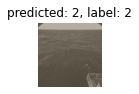

 17%|█▋        | 2/12 [00:42<03:18, 19.87s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:560/898
Acurácia: 0.623608017817372
----------------------


 25%|██▌       | 3/12 [00:56<02:34, 17.21s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:293/300
Acurácia: 0.9766666666666667
----------------------


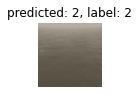

 33%|███▎      | 4/12 [01:02<01:41, 12.73s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


 42%|████▏     | 5/12 [01:09<01:15, 10.81s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:599/599
Acurácia: 1.0
----------------------


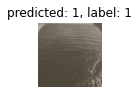

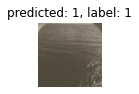

 50%|█████     | 6/12 [01:19<01:01, 10.32s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


 58%|█████▊    | 7/12 [01:33<00:58, 11.66s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 67%|██████▋   | 8/12 [01:48<00:50, 12.75s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 75%|███████▌  | 9/12 [02:01<00:38, 12.89s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


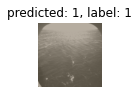

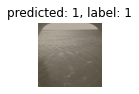

 83%|████████▎ | 10/12 [02:16<00:26, 13.40s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 92%|█████████▏| 11/12 [02:30<00:13, 13.62s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:898/900
Acurácia: 0.9977777777777778
----------------------


100%|██████████| 12/12 [02:44<00:00, 13.73s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_kaggle_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.93679   0.99982   0.96728      5455
           2    0.99914   0.89964   0.94679      3896
           3    0.97503   0.99778   0.98627       900

    accuracy                        0.96156     10251
   macro avg    0.97032   0.96575   0.96678     10251
weighted avg    0.96385   0.96156   0.96116     10251



#### Resnet34

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1660/1799
Acurácia: 0.9227348526959422
----------------------


  8%|▊         | 1/12 [00:13<02:26, 13.36s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:859/899
Acurácia: 0.9555061179087876
----------------------


 17%|█▋        | 2/12 [00:20<01:36,  9.66s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:677/898
Acurácia: 0.7538975501113586
----------------------


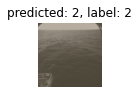

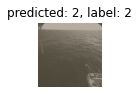

 25%|██▌       | 3/12 [00:27<01:16,  8.53s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:103/300
Acurácia: 0.3433333333333333
----------------------


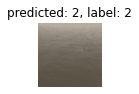

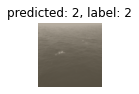

 33%|███▎      | 4/12 [00:30<00:51,  6.47s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


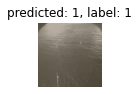

 42%|████▏     | 5/12 [00:34<00:38,  5.45s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:572/599
Acurácia: 0.9549248747913188
----------------------


 50%|█████     | 6/12 [00:39<00:31,  5.25s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:816/899
Acurácia: 0.9076751946607341
----------------------


 58%|█████▊    | 7/12 [00:46<00:28,  5.79s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:855/899
Acurácia: 0.9510567296996663
----------------------


 67%|██████▋   | 8/12 [00:53<00:24,  6.17s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 75%|███████▌  | 9/12 [01:00<00:19,  6.38s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:859/899
Acurácia: 0.9555061179087876
----------------------


 83%|████████▎ | 10/12 [01:07<00:13,  6.78s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 92%|█████████▏| 11/12 [01:14<00:06,  6.84s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:864/900
Acurácia: 0.96
----------------------


100%|██████████| 12/12 [01:21<00:00,  6.81s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_oversample_kaggle_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.89656   0.96444   0.92926      5455
           2    0.93989   0.84677   0.89090      3896
           3    0.98969   0.96000   0.97462       900

    accuracy                        0.91932     10251
   macro avg    0.94204   0.92373   0.93159     10251
weighted avg    0.92120   0.91932   0.91866     10251



#### Resnet152

Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1779/1799
Acurácia: 0.9888827126181212
----------------------


  8%|▊         | 1/12 [00:24<04:31, 24.67s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:882/899
Acurácia: 0.9810901001112347
----------------------


 17%|█▋        | 2/12 [00:37<02:54, 17.48s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:490/898
Acurácia: 0.5456570155902004
----------------------


 25%|██▌       | 3/12 [00:49<02:17, 15.27s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:46/300
Acurácia: 0.15333333333333332
----------------------


 33%|███▎      | 4/12 [00:54<01:30, 11.26s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:361/361
Acurácia: 1.0
----------------------


 42%|████▏     | 5/12 [01:01<01:07,  9.59s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:566/599
Acurácia: 0.9449081803005008
----------------------


 50%|█████     | 6/12 [01:10<00:55,  9.30s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:808/899
Acurácia: 0.8987764182424917
----------------------


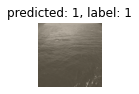

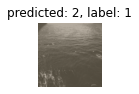

 58%|█████▊    | 7/12 [01:22<00:51, 10.35s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:829/899
Acurácia: 0.9221357063403782
----------------------


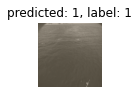

 67%|██████▋   | 8/12 [01:35<00:44, 11.09s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


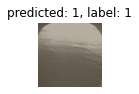

 75%|███████▌  | 9/12 [01:47<00:34, 11.54s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:897/899
Acurácia: 0.9977753058954394
----------------------


 83%|████████▎ | 10/12 [02:00<00:23, 11.85s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


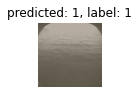

 92%|█████████▏| 11/12 [02:12<00:12, 12.03s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:894/900
Acurácia: 0.9933333333333333
----------------------


100%|██████████| 12/12 [02:25<00:00, 12.13s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_kaggle_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.88268   0.96407   0.92158      5455
           2    0.94112   0.82059   0.87673      3896
           3    0.99777   0.99333   0.99555       900

    accuracy                        0.91211     10251
   macro avg    0.94052   0.92600   0.93129     10251
weighted avg    0.91500   0.91211   0.91103     10251



#### Resnet34_VGG

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1781/1799
Acurácia: 0.9899944413563091
----------------------


  8%|▊         | 1/12 [00:13<02:33, 13.92s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:893/899
Acurácia: 0.9933259176863182
----------------------


 17%|█▋        | 2/12 [00:21<01:40, 10.01s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:832/898
Acurácia: 0.9265033407572383
----------------------


 25%|██▌       | 3/12 [00:28<01:17,  8.67s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:163/300
Acurácia: 0.5433333333333333
----------------------


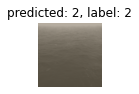

 33%|███▎      | 4/12 [00:31<00:52,  6.58s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:360/361
Acurácia: 0.997229916897507
----------------------


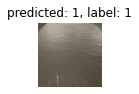

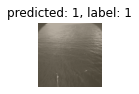

 42%|████▏     | 5/12 [00:35<00:38,  5.55s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:591/599
Acurácia: 0.986644407345576
----------------------


 50%|█████     | 6/12 [00:40<00:32,  5.40s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:826/899
Acurácia: 0.9187986651835373
----------------------


 58%|█████▊    | 7/12 [00:47<00:29,  5.97s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:887/899
Acurácia: 0.9866518353726362
----------------------


 67%|██████▋   | 8/12 [00:54<00:25,  6.36s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


 75%|███████▌  | 9/12 [01:01<00:19,  6.62s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:887/899
Acurácia: 0.9866518353726362
----------------------


 83%|████████▎ | 10/12 [01:08<00:13,  6.73s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:898/899
Acurácia: 0.9988876529477196
----------------------


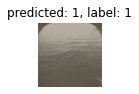

 92%|█████████▏| 11/12 [01:15<00:06,  6.80s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:880/900
Acurácia: 0.9777777777777777
----------------------


100%|██████████| 12/12 [01:22<00:00,  6.91s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_loss_kaggle_tpn')

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.95825   0.98038   0.96919      5455
           2    0.97192   0.94174   0.95659      3896
           3    0.98324   0.97778   0.98050       900

    accuracy                        0.96547     10251
   macro avg    0.97114   0.96663   0.96876     10251
weighted avg    0.96564   0.96547   0.96540     10251



### Metrics modelos Kaggle no dataset Kaggle

In [ ]:
def test_model_metrics(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  y_labels = []
  y_pred = []

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2,
        'kaggle_1': 0,
        'kaggle_2': 0,
        'kaggle_3': 0,
        'kaggle_4': 1
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            y_labels += [int(labels[i]) for i in range(labels.shape[0])]
            y_pred += [int(preds[i]) for i in range(preds.shape[0])]

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

  return y_labels, y_pred

#### VGG16

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'vgg16_splitted_kaggle_tpn')

Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1199/1200
Acurácia: 0.9991666666666666
----------------------


 25%|██▌       | 1/4 [00:14<00:42, 14.01s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:1199/1200
Acurácia: 0.9991666666666666
----------------------


 50%|█████     | 2/4 [00:27<00:27, 13.91s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:1140/1200
Acurácia: 0.95
----------------------


 75%|███████▌  | 3/4 [00:42<00:14, 14.18s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1083/1200
Acurácia: 0.9025
----------------------


100%|██████████| 4/4 [00:56<00:00, 14.03s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.98965   0.98278   0.98620      3600
           2    0.95251   0.90250   0.92683      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.96271      4800
   macro avg    0.64739   0.62843   0.63768      4800
weighted avg    0.98036   0.96271   0.97136      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Resnet34

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_oversample_kaggle_tpn')

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1183/1200
Acurácia: 0.9858333333333333
----------------------


 25%|██▌       | 1/4 [00:07<00:22,  7.49s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:1200/1200
Acurácia: 1.0
----------------------


 50%|█████     | 2/4 [00:15<00:15,  7.52s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:1153/1200
Acurácia: 0.9608333333333333
----------------------


 75%|███████▌  | 3/4 [00:22<00:07,  7.51s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:919/1200
Acurácia: 0.7658333333333334
----------------------


100%|██████████| 4/4 [00:30<00:00,  7.51s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.93397   0.98222   0.95749      3600
           2    0.93776   0.76583   0.84312      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.92812      4800
   macro avg    0.62391   0.58269   0.60020      4800
weighted avg    0.93491   0.92812   0.92890      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Resnet152

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet152_splitted_kaggle_tpn')

Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1200/1200
Acurácia: 1.0
----------------------


 25%|██▌       | 1/4 [00:14<00:43, 14.58s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:1199/1200
Acurácia: 0.9991666666666666
----------------------


 50%|█████     | 2/4 [00:29<00:29, 14.63s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:1161/1200
Acurácia: 0.9675
----------------------


 75%|███████▌  | 3/4 [00:44<00:14, 14.73s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1192/1200
Acurácia: 0.9933333333333333
----------------------


100%|██████████| 4/4 [00:59<00:00, 14.76s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.99776   0.98889   0.99330      3600
           2    0.96753   0.99333   0.98026      1200

    accuracy                        0.99000      4800
   macro avg    0.98265   0.99111   0.98678      4800
weighted avg    0.99020   0.99000   0.99004      4800



#### Resnet34_VGG

In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_vgg_splitted_weighted_loss_kaggle_tpn')

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1187/1200
Acurácia: 0.9891666666666666
----------------------


 25%|██▌       | 1/4 [00:07<00:23,  7.69s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:1198/1200
Acurácia: 0.9983333333333333
----------------------


 50%|█████     | 2/4 [00:15<00:15,  7.62s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:1183/1200
Acurácia: 0.9858333333333333
----------------------


 75%|███████▌  | 3/4 [00:22<00:07,  7.60s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:600/1200
Acurácia: 0.5
----------------------


100%|██████████| 4/4 [00:30<00:00,  7.59s/it]


In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

              precision    recall  f1-score   support

           1    0.89424   0.99111   0.94018      3600
           2    0.97245   0.50000   0.66043      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.86833      4800
   macro avg    0.62223   0.49704   0.53354      4800
weighted avg    0.91379   0.86833   0.87025      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Rascunho

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


  0%|          | 0/12 [00:00<?, ?it/s]

----------------------
Dataset: AA_2014_2014-03-27_09-10-00_12Hz 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1778/1799
Acurácia: 0.9883268482490273
----------------------


  8%|▊         | 1/12 [00:14<02:43, 14.90s/it]

----------------------
Dataset: AA_2015_2015-03-05_10-35-00_12Hz 

Num de acertos/Num de samples:893/899
Acurácia: 0.9933259176863182
----------------------


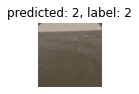

 17%|█▋        | 2/12 [00:21<01:39,  9.91s/it]

----------------------
Dataset: AA_2015_2015-05-15_09-00-00_12Hz 

Num de acertos/Num de samples:762/898
Acurácia: 0.8485523385300668
----------------------


 25%|██▌       | 3/12 [00:28<01:17,  8.59s/it]

----------------------
Dataset: YS_2017_2017-05-13_05-00-00_10Hz 

Num de acertos/Num de samples:137/300
Acurácia: 0.45666666666666667
----------------------


 33%|███▎      | 4/12 [00:31<00:51,  6.48s/it]

----------------------
Dataset: BS_2011_2011-10-01_16-18-00_15Hz 

Num de acertos/Num de samples:359/361
Acurácia: 0.9944598337950139
----------------------


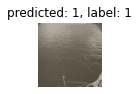

 42%|████▏     | 5/12 [00:34<00:37,  5.35s/it]

----------------------
Dataset: BS_2011_2011-10-04_11-38-00_12Hz 

Num de acertos/Num de samples:587/599
Acurácia: 0.9799666110183639
----------------------


 50%|█████     | 6/12 [00:39<00:31,  5.21s/it]

----------------------
Dataset: BS_2011_2011-10-04_13-07-00_12Hz 

Num de acertos/Num de samples:797/899
Acurácia: 0.8865406006674083
----------------------


 58%|█████▊    | 7/12 [00:47<00:29,  5.99s/it]

----------------------
Dataset: BS_2011_2011-10-04_15-30-00_12Hz 

Num de acertos/Num de samples:878/899
Acurácia: 0.9766407119021134
----------------------


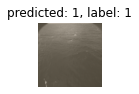

 67%|██████▋   | 8/12 [00:55<00:26,  6.52s/it]

----------------------
Dataset: BS_2013_2013-09-22_13-00-01_10Hz 

Num de acertos/Num de samples:899/899
Acurácia: 1.0
----------------------


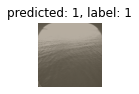

 75%|███████▌  | 9/12 [01:02<00:20,  6.88s/it]

----------------------
Dataset: BS_2013_2013-09-25_12-15-01_12Hz 

Num de acertos/Num de samples:867/899
Acurácia: 0.96440489432703
----------------------


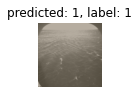

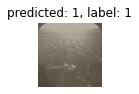

 83%|████████▎ | 10/12 [01:10<00:14,  7.06s/it]

----------------------
Dataset: BS_2013_2013-09-30_10-20-01_12Hz 

Num de acertos/Num de samples:893/899
Acurácia: 0.9933259176863182
----------------------


 92%|█████████▏| 11/12 [01:17<00:07,  7.16s/it]

----------------------
Dataset: LJ_2018_2018-01-03_09-39-38_10Hz 

Num de acertos/Num de samples:900/900
Acurácia: 1.0
----------------------


100%|██████████| 12/12 [01:24<00:00,  7.02s/it]


In [ ]:
datasets = [
    'AA_2014_2014-03-27_09-10-00_12Hz',
    'AA_2015_2015-03-05_10-35-00_12Hz',
    'AA_2015_2015-05-15_09-00-00_12Hz',
    'YS_2017_2017-05-13_05-00-00_10Hz',
    'BS_2011_2011-10-01_16-18-00_15Hz',
    'BS_2011_2011-10-04_11-38-00_12Hz',
    'BS_2011_2011-10-04_13-07-00_12Hz',
    'BS_2011_2011-10-04_15-30-00_12Hz',
    'BS_2013_2013-09-22_13-00-01_10Hz',
    'BS_2013_2013-09-25_12-15-01_12Hz',
    'BS_2013_2013-09-30_10-20-01_12Hz',
    'LJ_2018_2018-01-03_09-39-38_10Hz'
  ]

y_labels, y_preds = test_model_metrics(datasets, 'resnet34_splitted_weighted_oversample_tpn')

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

# fig, ax = plt.subplots(figsize=(7.5, 7.5))
# ax.matshow(conf_matrix, cmap=plt.cm.Blues, alpha=0.3)
# for i in range(conf_matrix.shape[0]):
#     for j in range(conf_matrix.shape[1]):
#         ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
# plt.xlabel('Predictions', fontsize=18)
# plt.ylabel('Labels', fontsize=18)
# plt.title('Confusion Matrix', fontsize=18)
# plt.show()

              precision    recall  f1-score   support

           1    0.94269   0.96792   0.95514      5455
           2    0.96097   0.91632   0.93812      3896
           3    0.96257   1.00000   0.98093       900

    accuracy                        0.95113     10251
   macro avg    0.95541   0.96141   0.95806     10251
weighted avg    0.95138   0.95113   0.95093     10251



In [ ]:
# Carrega as imagens pré-processadas de cada dataset
base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'

with open(base_dir + 'LJ_2018_2018-01-03_09-39-38_10Hz_2058_600.pkl', 'rb') as f:
    data = pickle.load(f)

# with open(base_dir + 'BS_2011_2011-10-04_15-30-00_12Hz_2058_600.pkl', 'rb') as f:
#     data = pickle.load(f)

# with open(base_dir + 'LJ_2018_2018-01-03_09-39-38_10Hz_2058_600.pkl', 'rb') as f:
#     data = pickle.load(f)

# with open(base_dir + 'AA_2015_2015-03-05_10-35-00_12Hz_2058_224.pkl', 'rb') as f:
#     data = pickle.load(f)

# YS_2017 = torch.load('YS_2017_2017-05-13_05-00-00_10Hz_2058_600.pt')
# AA_2015 = torch.load('AA_2015_2015-03-05_10-35-00_12Hz_preproc_2058_600.pt')
# BS_2011_1 = torch.load('BS_2011_2011-10-04_11-38-00_12Hz_2058_600.pt')
# BS_2011_2 = torch.load('BS_2011_2011-10-01_16-18-00_15Hz_preproc_2058_600.pt')

# Concatena todos os sets em um e atribui os labels às imagens
# em uma tupla: (<tensor>, <classe>)
data = [(x, 2) for x in data]
# data += [(x, 1) for x in YS_2017]
# data += [(x, 2) for x in LJ_2018]

In [ ]:
# Normalização e conversão em tensores
transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),  # Transform to tensor
        transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
])

data = [(transform(img), label) for img, label in data]

# Split data into training/test set (80/20)
# train_size = int(0.8 * len(data))
# test_size = len(data) - train_size
# train_set, test_set = torch.utils.data.random_split(data, [train_size, test_size])

# image_datasets = {'train': train_set, 'val': test_set}

# dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4,
#                                              shuffle=True, num_workers=4)
#               for x in ['train', 'val']}
dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}
# dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = [1, 2, 3]

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
device

device(type='cuda', index=0)

In [ ]:
model = models.resnet152(pretrained=True)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 3)
model.load_state_dict(torch.load('/content/gdrive/Shareddrives/TCC - S09/Notebooks/resnet_leave_out_tpn.pth', map_location=lambda storage, loc: storage))
print('Model loaded from %s.' % 'resnet152_linear_1_1_1')
model.to(device)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from resnet152_teste.


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
def test_all(model):
  model.eval()
  count = 0

  with torch.no_grad():
      for i, (inputs, labels) in enumerate(dataloaders['val']):
          inputs = inputs.to(device)
          labels = labels.to(device)

          outputs = model(inputs)
          _, preds = torch.max(outputs, 1)

          count += torch.sum(preds)
          

      print('Num de erros:', count)
      print('Acurácia:', count/len(data))

test_all(model)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de erros: tensor(147, device='cuda:0')
Acurácia: tensor(0.0818, device='cuda:0')


In [ ]:
torch.sum(torch.Tensor([1,2,3]))

tensor(6.)

In [ ]:
len(dataloaders['val'])

450

In [ ]:
1-0.0818

0.9182

In [ ]:
resnet34_teste = models.resnet34(pretrained=True)
resnet34_teste

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
resnet34_teste.fc = nn.Sequential(
    nn.Linear(in_features=512, out_features=512, bias=True),
    nn.ReLU(inplace=True),
    nn.Dropout(p=0.5, inplace=False),
    nn.Linear(in_features=512, out_features=3, bias=True)
)

resnet34_teste

#     (0): Linear(in_features=25088, out_features=4096, bias=True)
#     (1): ReLU(inplace=True)
#     (2): Dropout(p=0.5, inplace=False)
#     (3): Linear(in_features=4096, out_features=4096, bias=True)
#     (4): ReLU(inplace=True)
#     (5): Dropout(p=0.5, inplace=False)
#     (6): Linear(in_features=4096, out_features=1000, bias=True)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
vgg16_teste = models.vgg16_bn(pretrained=True)
vgg16_teste

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256